# COVID-19 Dataset Analysis

This analysis was created for the Data100 Spring 2020 Final Project. 

**Created by**: Kunal Adhia, Sravya Basvapatri, and Shreya Mohanty

Sources for datasets used in this analyis can be found here.
Our datasets were updated from the latest versions available when completing our analysis. 

- County Data: https://github.com/Yu-Group/covid19-severity-prediction/blob/master/data/county_data_abridged.csv

- States (Daily Reports as of 5/4): https://github.com/CSSEGISandData/COVID-19/tree/master/csse_covid_19_data/csse_covid_19_daily_reports_us

- Time Series Data (Confirmed US, Deaths US, Confirmed Global, Deaths Global, Recovered Global): https://github.com/CSSEGISandData/COVID-19/tree/master/csse_covid_19_data/csse_covid_19_time_series

- Time Series Data for US Counties (Confirmed, Deaths): Source: https://usafacts.org/visualizations/coronavirus-covid-19-spread-map/

- County Health Rankings: https://app.namara.io/#/data_sets/579ee1c6-8f66-418c-9df9-d7b5b618c774?organizationId=5eb9b68ca3b79c000f3fd1a9

In [1]:
import sys

#Uncomment these if receiving errors
# !{sys.executable} -m pip install numpy
# !{sys.executable} -m pip install pandas
# !{sys.executable} -m pip install matplotlib
# !{sys.executable} -m pip install seaborn
# !{sys.executable} -m pip install plotly
# !{sys.executable} -m pip install sklearn

import numpy as np
import pandas as pd
from pandas import Timestamp
from datetime import timedelta
from sklearn.model_selection import train_test_split, KFold, cross_val_score
import sklearn.linear_model as lm
from sklearn.linear_model import Lasso
import matplotlib.pyplot as plt
from IPython.display import Image

import matplotlib.pyplot as plt
import seaborn as sns
import plotly as ply
import plotly.graph_objects as go

## Abstract

We were interested in understanding factors that affect the spread and fatality of COVID-19, as well as predicting how the pandemic would affect different areas in the coming weeks. 

### [In the United States](#In-The-US)
**[Analyzing Mortality Rates in United States Counties](#Mortality-Rates)**

We first raise the question of which United States counties are affected the most by coronavirus cases, analyzed in terms of morality rates. This builds an understanding of which counties are hit the hardest by the pandemic. This information would be used to make more vulnerable populations aware of measures they need to take and help us as a society provide more equitable care, bringing resources to areas that need them the most. 

Due to a vast difference in the number of cases across counties, mortality rates tended to be skewed to 0% for about 15% of the counties and were very high for many rural areas that had only experienced a few fatal cases. As a result, it was very difficult to create a model to predict mortality rates as there wasn't too many patterns we identified.

**[Predicting Growth of Cases per 100K Population in the United States Counties](#Predicting-Cases)**

We then analyzed the number of cases per 100K population in U.S. counties, creating and training a model to predict the number of cases per 100K population. In the process we identified features that were useful in predicting the number of cases, as well as using time series data to predict the number of cases one month into the future.   We used a linear regression model, but it tended to underpredict the number of cases often.

###  [A Global View](#A-Global-View)
**[Predicting Growth of Number of Cases in Different Countries](#World-Predictions)** 

Shifting our focus to a broader global scale, we had more comprehensive data and wanted to predict how the number of cases would change into the future. Fitting a logistic curve, we were able to the predict number of cases in world countries a week into the future. This information would help countries that are still at the beginning of their curve understand how to best prepare for the pandemic. 

### [Further Questions](#Further-Questions)

While we took many approaches to analyzing the data, this raised many new questions about how we could make better predictions and gain a better understanding of what factors influence how a population is affected by coronavirus. 

<a id='In-The=US'></a>

## In the United States: Analyzing Mortality Rates in U.S. Counties

With a little exploration into the original time series data (provided in the Appendix notebook) for confirmed cases and deaths within the US, we saw the red flag of particularly low mortality rates in RI and WY. We realized that the time series deaths dataset didn't contain updated county-level information within these two states, and switched over to a dataset from USA Facts (source above) that would allow us to do more comprehensive county-level analysis.

### Data Cleaning: Counties Time Series Dataset from USA Facts

In [2]:
# Looking a new time series data set
cases_US = pd.read_csv("covid_confirmed_usafacts.csv")
deaths_US = pd.read_csv("covid_deaths_usafacts.csv")
url = "https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_daily_reports_us/05-04-2020.csv"
states_daily = pd.read_csv(url)

# Turning FIPs to standardized length as strings
cases_US["stateFIPS"] = cases_US["stateFIPS"].astype(str).apply(lambda x: x.zfill(2))
cases_US["countyFIPS"] = cases_US["countyFIPS"].astype(str).apply(lambda x: x.zfill(5))
deaths_US["stateFIPS"] = deaths_US["stateFIPS"].astype(str).apply(lambda x: x.zfill(2))
deaths_US["countyFIPS"] = deaths_US["countyFIPS"].astype(str).apply(lambda x: x.zfill(5))
states_daily["FIPS"] = states_daily["FIPS"].astype(str).apply(lambda x: x.zfill(2))

In [3]:
cases_US["5/4/20"].sum() #1,173,184 cases
states_cases = cases_US.groupby("State")[["5/4/20"]].sum().rename(columns = {"5/4/20": "Cases"})
states_deaths = deaths_US.groupby("State")[["5/4/20"]].sum().rename(columns = {"5/4/20": "Deaths"})
states_total_data = states_cases.join(states_deaths, on = ["State"])
states_total_data["Mortality_Rate"] = states_total_data["Deaths"]/states_total_data["Cases"]*100
states_total_data.head()

,Cases,Deaths,Mortality_Rate
State,,,
AK,371,9,2.425876
AL,8110,298,3.674476
AR,3463,80,2.310136
AZ,8919,362,4.058751
CA,56140,2282,4.064838


### Exploratory Data Analysis: State and County Level Map Views

The following visualization looks at mortality rates by state in the United States. We can see that Michigan, New York, Conneticut, and Lousiana have slightly higher mortality rates, although most states tend to be fairly homogenously colored. This led us to explore further granularity at the county level. 

In [4]:
import plotly.express as px
from urllib.request import urlopen
import json

with urlopen('https://raw.githubusercontent.com/PublicaMundi/MappingAPI/master/data/geojson/us-states.json') as response:
    states_json = json.load(response)

fig = px.choropleth_mapbox(states_daily, geojson=states_json, locations='FIPS', color='Mortality_Rate',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           mapbox_style="carto-positron",
                           zoom=3, center = {"lat": 37.0902, "lon": -95.7129},
                           opacity=0.5,
                           labels={'Mortality_Rate':'Mortality Rate'}
                          )
fig.update_layout(
    title = "Coronavirus Mortality Rates in United States",
    margin={"r":0,"t":0,"l":0,"b":0}
)
fig.show()

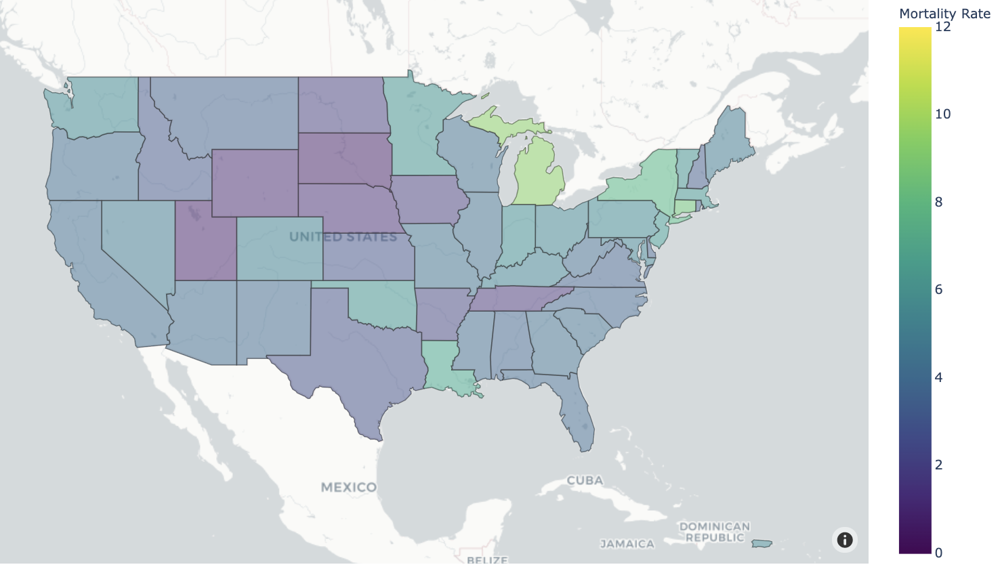

In [5]:
Image("mortality_rate_state.png")

In [6]:
counties_cases_US = cases_US[cases_US["countyFIPS"] != "00000"][["countyFIPS", "County Name", "State", "stateFIPS", "5/4/20"]].rename(columns = {"5/4/20": "Cases"}).set_index("countyFIPS")
counties_deaths_US = deaths_US[deaths_US["countyFIPS"] != "00000"][["5/4/20", "countyFIPS"]].rename(columns = {"5/4/20": "Deaths"}).set_index("countyFIPS")
US_counties_total_data = counties_cases_US.join(counties_deaths_US)
US_counties_total_data["Mortality_Rate"] = (US_counties_total_data["Deaths"]/US_counties_total_data["Cases"]*100).fillna(0)
US_counties_total_data["countyFIPS"] = US_counties_total_data.index
US_counties_total_data

,County Name,State,stateFIPS,Cases,Deaths,Mortality_Rate,countyFIPS
countyFIPS,,,,,,,
01001,Autauga County,AL,01,53,3,5.660377,01001
01003,Baldwin County,AL,01,188,4,2.127660,01003
01005,Barbour County,AL,01,45,1,2.222222,01005
01007,Bibb County,AL,01,42,0,0.000000,01007
01009,Blount County,AL,01,40,0,0.000000,01009
...,...,...,...,...,...,...,...
56037,Sweetwater County,WY,56,11,0,0.000000,56037
56039,Teton County,WY,56,67,1,1.492537,56039
56041,Uinta County,WY,56,6,0,0.000000,56041


In [7]:
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties_json = json.load(response)

fig = px.choropleth_mapbox(US_counties_total_data, geojson=counties_json, locations='countyFIPS', color='Mortality_Rate',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           mapbox_style="carto-positron",
                           zoom=3, center = {"lat": 37.0902, "lon": -95.7129},
                           opacity=0.5,
                           labels={'Mortality_Rate':'Mortality Rate'}
                          )
fig.update_layout(
    title = "Coronavirus Mortality Rates in United States by County",
    margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

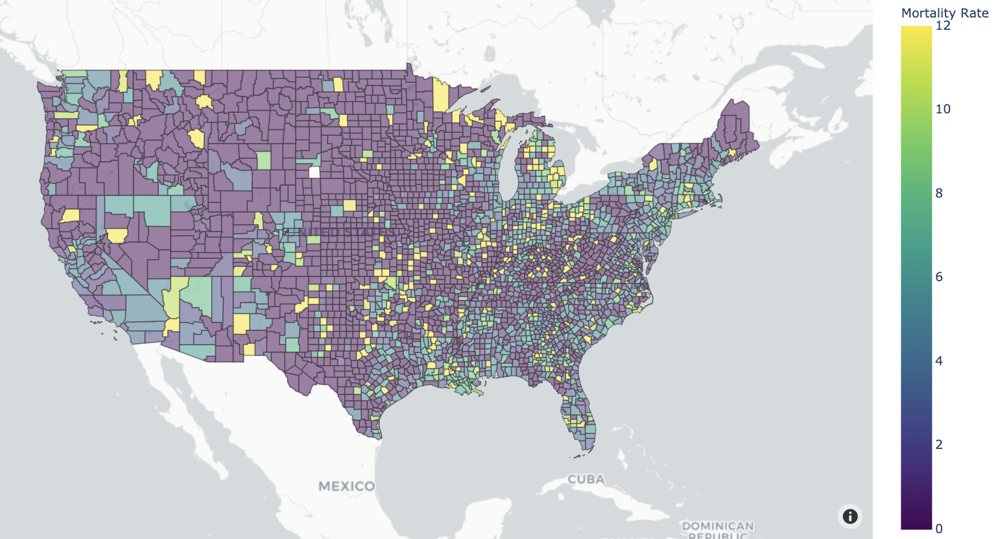

In [8]:
Image("mortality_rate_county.png")

From this visualization, we can see that many counties have mortality rates that are greater than 12%, and many of these seem to be in the east and west rather than in the center of the country. Beyond that, however, there didn't seem to be too much of a geographical explanation, so we decided to explore factors that contributed to higher mortality rates.

<a id='Mortality-Rates'></a>

### Analyzing Risk Factors in Counties Related to Mortality Rates
#### Further Data Selection and Cleaning Motivated by EDA

In this section, we analyze health risks and other outcome factors in US counties that affect coronavirus cases and deaths. We combine both the abridged_counties dataset and with the data analyzed above with mortality rates per county in an effort to understand what factors.

First, we selected relevant columns from the counties dataset and added another updated 2019 population count to the provided dataset.

In [9]:
counties_2019_pop = pd.read_csv('covid_county_population_usafacts.csv')
counties = pd.read_csv('county_data_abridged.csv')
print(counties.shape)

#selecting relevant columns from county data
#(pre-selecting columns for ease of data use, but can be editer late to include more columns as features)
# Select columns to use in analysis from abridged_counties dataset
counties = counties[["countyFIPS", 
                    "CountyName",  
                    "StateName", 
                    "Rural-UrbanContinuumCode2013",
                    "PopulationEstimate65+2017",
                    "PopulationDensityperSqMile2010", 
                    "#ICU_beds",
                    "#Hospitals",
                    "HeartDiseaseMortality", 
                    "StrokeMortality", 
                    "RespMortalityRate2014",  
                    "DiabetesPercentage", 
                    "Smokers_Percentage"]]

# Fill FIP values to be length 5 strings
counties_2019_pop["countyFIPS"] = counties_2019_pop["countyFIPS"].astype('str').apply(lambda x: x.zfill(5))
print(counties_2019_pop.shape)

# Drop "State" because it has NaN values and merge with counties population
counties = counties.merge(counties_2019_pop, on='countyFIPS')
counties.drop(['County Name', 'State'], axis=1, inplace = True)
counties.rename({'StateName':'StateAbbrev'}, axis=1, inplace=True)
print(counties.shape)
counties.head()

(3244, 87)
(3195, 4)
(3141, 14)


,countyFIPS,CountyName,StateAbbrev,Rural-UrbanContinuumCode2013,PopulationEstimate65+2017,PopulationDensityperSqMile2010,#ICU_beds,#Hospitals,HeartDiseaseMortality,StrokeMortality,RespMortalityRate2014,DiabetesPercentage,Smokers_Percentage,population
0,01001,Autauga,AL,2.0,8392.0,91.8,6.0,1.0,204.5,56.1,81.79,9.9,18.081557,55869
1,01003,Baldwin,AL,3.0,42413.0,114.7,51.0,3.0,183.2,41.9,54.28,8.5,17.489033,223234
2,01005,Barbour,AL,6.0,4757.0,31.0,5.0,1.0,220.4,49.0,69.82,15.7,21.999985,24686
3,01007,Bibb,AL,1.0,3632.0,36.8,0.0,1.0,225.5,57.2,84.49,13.3,19.114200,22394
4,01009,Blount,AL,1.0,10351.0,88.9,6.0,1.0,224.8,52.8,87.05,14.9,19.208672,57826


Next, we dealt with NaN values, and merged with the earlier US_counties_total_data. A search revealed that the majority of missing values are from counties in Alaska, so we dropped missing values

In [10]:
counties.isna().sum()

countyFIPS                        0
CountyName                        0
StateAbbrev                       0
Rural-UrbanContinuumCode2013      0
PopulationEstimate65+2017         0
PopulationDensityperSqMile2010    0
#ICU_beds                         0
#Hospitals                        0
HeartDiseaseMortality             7
StrokeMortality                   8
RespMortalityRate2014             0
DiabetesPercentage                1
Smokers_Percentage                0
population                        0
dtype: int64

In [11]:
#analysis shows that most null values are in buroughs/census areas in Alaska, with two from South Dakota
'''is_NaN = counties.isnull()
row_has_NaN = is_NaN.any(axis=1)
rows_with_NaN = counties[row_has_NaN]
print(rows_with_NaN)'''

# We decided to replace these values with the average from the state
SD_diabetes_avg = counties[counties['StateAbbrev'] == 'SD']['DiabetesPercentage'].mean()
counties.iloc[2390, 9] = SD_diabetes_avg
SD_stroke_avg = counties[counties['StateAbbrev'] == 'SD']['StrokeMortality'].mean()
counties.iloc[2390, 7] = SD_stroke_avg

counties = counties.fillna(counties[counties["StateAbbrev"] == "AK"].mean())
counties.isna().sum()

# Rename so counties can be used in later time series analysis
static_counties = counties

In [12]:
# Join US_counties_total_data with selected abridged_counties data, add a %Affected, %65+ column

static_counties.set_index("countyFIPS")
print(US_counties_total_data.shape)
county_chosen_data = static_counties.merge(US_counties_total_data[["Cases", "Deaths", "Mortality_Rate"]], on = ["countyFIPS"])
county_chosen_data["%Affected"] = county_chosen_data["Cases"]/(county_chosen_data["population"])*100
county_chosen_data["%65+pop_estimates"] = county_chosen_data["PopulationEstimate65+2017"]/(county_chosen_data["population"])*100
county_chosen_data["CasesPer100K"] = 100000 * county_chosen_data["Cases"]/county_chosen_data["population"]
county_chosen_data["DeathsPer100K"] = 100000 * county_chosen_data["Deaths"]/county_chosen_data["population"]
print(county_chosen_data.shape)
county_chosen_data.head()

(3145, 7)
(3141, 21)


,countyFIPS,CountyName,StateAbbrev,Rural-UrbanContinuumCode2013,PopulationEstimate65+2017,PopulationDensityperSqMile2010,#ICU_beds,#Hospitals,HeartDiseaseMortality,StrokeMortality,...,DiabetesPercentage,Smokers_Percentage,population,Cases,Deaths,Mortality_Rate,%Affected,%65+pop_estimates,CasesPer100K,DeathsPer100K
0,01001,Autauga,AL,2.0,8392.0,91.8,6.0,1.0,204.5,56.1,...,9.9,18.081557,55869,53,3,5.660377,0.094865,15.020852,94.864773,5.369704
1,01003,Baldwin,AL,3.0,42413.0,114.7,51.0,3.0,183.2,41.9,...,8.5,17.489033,223234,188,4,2.127660,0.084217,18.999346,84.216562,1.791842
2,01005,Barbour,AL,6.0,4757.0,31.0,5.0,1.0,220.4,49.0,...,15.7,21.999985,24686,45,1,2.222222,0.182290,19.270032,182.289557,4.050879
3,01007,Bibb,AL,1.0,3632.0,36.8,0.0,1.0,225.5,57.2,...,13.3,19.114200,22394,42,0,0.000000,0.187550,16.218630,187.550237,0.000000
4,01009,Blount,AL,1.0,10351.0,88.9,6.0,1.0,224.8,52.8,...,14.9,19.208672,57826,40,0,0.000000,0.069173,17.900252,69.173036,0.000000


### Data Visualizations for County Mortality Rates

Next, we can focus on addressing our initial question of understanding how mortality rates differ across US counties.
In our exploration, we used this information to develop features for a model, however, we realized that mortality rates are very difficult to predict because they skew very low or very high in counties that haven't seen many COVID-19 cases. The analysis below explains why, and the full model is included in the Appendix file.

First, I was curious whether there was a differece between mortality rates in rural and urban counties. 

Metro counties:
- 1 (Counties in metro areas of 1 million population or more)
- 2 (Counties in metro areas of 250,000 to 1 million population)
- 3 (Counties in metro areas of fewer than 250,000 population)

Nonmetro counties:
- 4 (Urban population of 20,000 or more, adjacent to a metro area)
- 5 (Urban population of 20,000 or more, not adjacent to a metro area)
- 6 (Urban population of 2,500 to 19,999, adjacent to a metro area)
- 7 (Urban population of 2,500 to 19,999, not adjacent to a metro area)
- 8 (Completely rural or less than 2,500 urban population, adjacent to a metro area)
- 9 (Completely rural or less than 2,500 urban population, not adjacent to a metro area)
Source: https://seer.cancer.gov/seerstat/variables/countyattribs/ruralurban.html

Text(0.5, 1.0, 'Mortality Rates by Rural Continuum Code, U.S. Counties with Positive Mortality Rates')

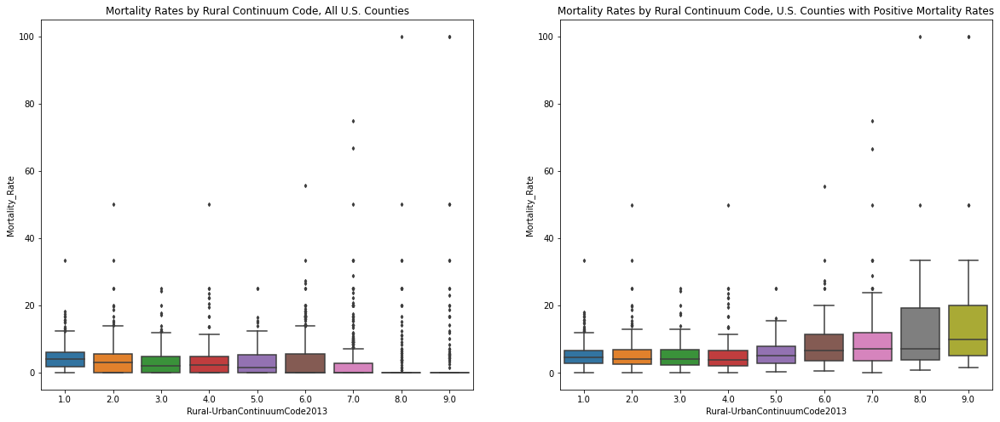

In [13]:
fig, ax = plt.subplots(1, 2, figsize=(20, 8))
sns.boxplot(
    x="Rural-UrbanContinuumCode2013",
    y="Mortality_Rate",
    data=county_chosen_data,
    fliersize=3,
    ax = ax[0]
)

sns.boxplot(
    x="Rural-UrbanContinuumCode2013",
    y="Mortality_Rate",
    data= county_chosen_data[county_chosen_data["Mortality_Rate"] != 0],
    fliersize=3,
    ax = ax[1]
)

ax[0].set_title("Mortality Rates by Rural Continuum Code, All U.S. Counties")
ax[1].set_title("Mortality Rates by Rural Continuum Code, U.S. Counties with Positive Mortality Rates")

We see that the overall mortality rates are lower in more rural areas, which makes sense because the virus is less likely to spread in rural areas. These are likely counties with few cases that recovered. However, when we look only at positive mortality rates (counties that have had at least one COVID-19 related death), we see that mortality is positively correlated with the rural-urban continuum code of a county. This hints that cases in rural areas may be more fatal, perhaps due to other factors, such as availability of health care. It could also simply be because these counties had a small number of cases, of which a few happened to be fatal.

Next, we take a look at how mortality rates are linked with the population density of a county.
The first scatterplot shows all U.S. counties, and the second filters out those with mortality rates greater than 20% and population density greater than 4000 per sq. mile to allow us to get a better look at the clustered data. 

Text(0.5, 1.0, 'Mortality Rates by Population Density, U.S. Counties (Zoomed In Scale)')

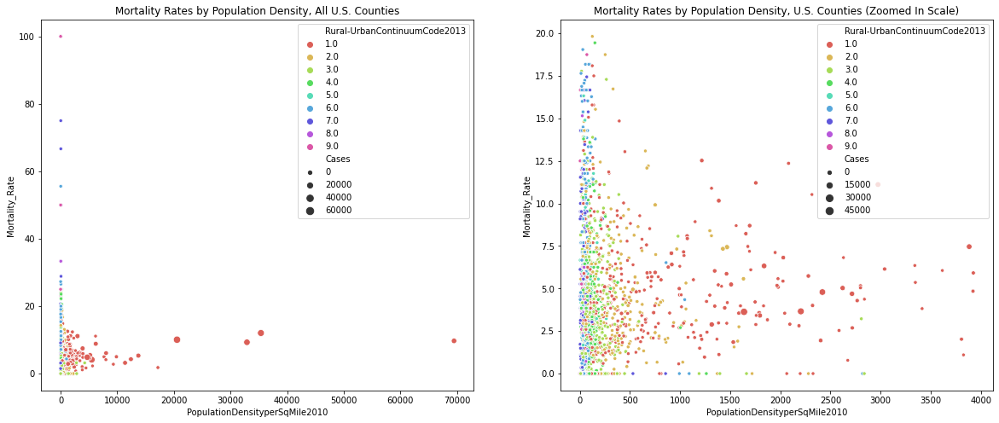

In [14]:
fig, ax = plt.subplots(1, 2, figsize=(20, 8))
sns.scatterplot(x="PopulationDensityperSqMile2010", 
                y="Mortality_Rate", 
                data = county_chosen_data, 
                size = "Cases",
                hue ="Rural-UrbanContinuumCode2013",
                palette = sns.hls_palette(9),
                alpha = 1, 
                ax = ax[0])
sns.scatterplot(x="PopulationDensityperSqMile2010", 
                y="Mortality_Rate", 
                data = county_chosen_data[(county_chosen_data["Mortality_Rate"] < 20) & (county_chosen_data["PopulationDensityperSqMile2010"] < 4000)], 
                size = "Cases",
                hue ="Rural-UrbanContinuumCode2013",
                palette = sns.hls_palette(9),
                alpha = 1, 
                ax = ax[1])

ax[0].set_title("Mortality Rates by Population Density, All U.S. Counties")
ax[1].set_title("Mortality Rates by Population Density, U.S. Counties (Zoomed In Scale)")

From these scatterplots, we can see two things. First, greater population density is generally positively correlated with a greater number of cases, shown by the growing sizes of the points as we move along the x-axis. 

Considering the correlation between population density and mortality rates is more complicated. We can see that population density is a poor indicator of mortality rate in more rural areas (shown in blues, purples, and pinks), but a better indicator of the mortality rate in more urban counties (shown in red).

In [15]:
percent_zero_all = (county_chosen_data[county_chosen_data["Mortality_Rate"] == 0]).size/county_chosen_data.shape[0]
print("Percent of 0% Mortality in Data: {}".format(percent_zero_all))

Percent of 0% Mortality in Data: 10.88443170964661


After trying to develop a linear model to fit mortality rates, I found that the model was extremely difficult to fit because many counties mortality rates at 0% simply because they hadn't seen much of the outbreak. 

The model didn't perform any better than predicting the mean, even after removing outliers. 

Seeing the large number of 0% mortality rates and odd extremely high mortality rates in rural areas, we can see that another metric might be better to predict, such as cases or deaths per 100K people. 

<a id='Predicting-Cases'></a>

## Predicting Cases per 100K People

This section focuses on predicting the number cases for every 100K people, and develops a model used to predict the number of cases one month into the future. We can see from that map that there are few counties that are outliers, but in the counties that are known to be hit the hardest (i.e. NYC), the cases per 100K are around 2000-3000.

In [16]:
fig = px.choropleth_mapbox(county_chosen_data, geojson=counties_json, locations='countyFIPS', color='CasesPer100K',
                           color_continuous_scale="Viridis",
                           range_color=(0, 500),
                           mapbox_style="carto-positron",
                           zoom=3, center = {"lat": 37.0902, "lon": -95.7129},
                           opacity=0.5,
                           labels={'Mortality_Rate':'Mortality Rate', 'CasesPer100K' : 'CasesPer100K'}
                          )
fig.update_layout(
    title= "Coronavirus Cases per 100K by US County",
    margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

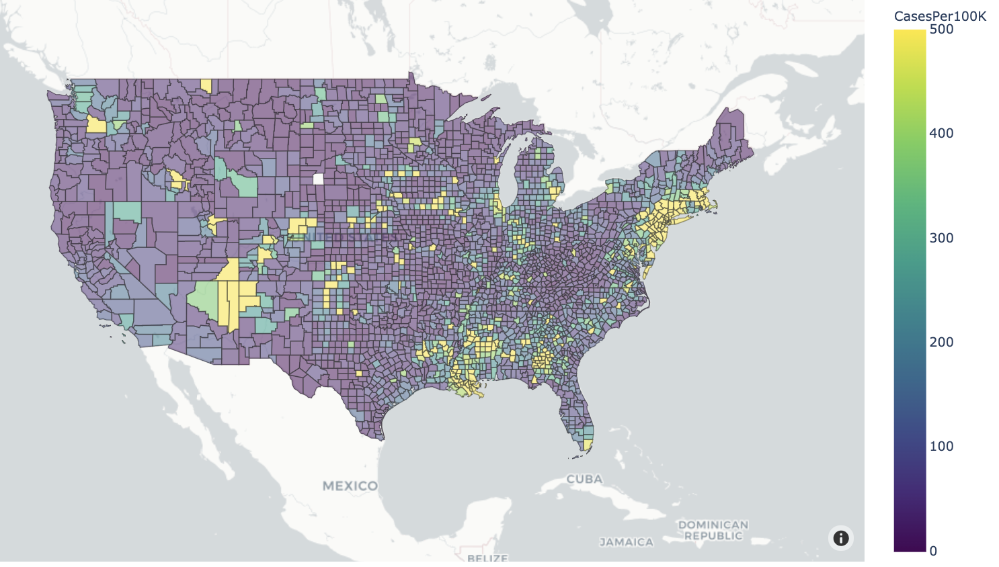

In [17]:
Image("cases_county.png")

### Data Cleaning

Here, we will use the counties dataframe that was cleaned earlier in the mortality rates analysis. We have already replaced null values and added a population column. We also bring in the raw time series data from USA facts and health ranking information found on Namara and Kaggle. 

In [18]:
counties_confirmed = pd.read_csv('covid_confirmed_usafacts.csv')
county_health_rankings = pd.read_csv('us-county-health-rankings-2020.csv')

In [19]:
# Drop counties data not need from earlier analysis
counties.drop(["PopulationDensityperSqMile2010", "Smokers_Percentage"], axis = 1)

#get rid of granular columns from county health data
county_health_rankings.columns
for drop in ['95percent', 'quartile', 'aian', 'asian', 'black','hispanic', 'white', 'american_indian_alaska_native', 'native_hawaiian_other_pacific_islander']:
    county_health_rankings.drop(list(county_health_rankings.filter(regex = drop)), axis = 1, inplace = True)

#select relevant columns from county health data
county_health_rankings = county_health_rankings[['fips', 'state', 'county', 'years_of_potential_life_lost_rate', 
                                                'percent_fair_or_poor_health', 'percent_low_birthweight', 
                                                 'percent_smokers', 'percent_adults_with_obesity',
                                               'food_environment_index', 'num_primary_care_physicians', 
                                                'preventable_hospitalization_rate', 'percent_vaccinated', 
                                                'percent_children_in_poverty', 'overcrowding',  'percent_food_insecure', 
                                                'num_rural']]
county_health_rankings.head()

,fips,state,county,years_of_potential_life_lost_rate,percent_fair_or_poor_health,percent_low_birthweight,percent_smokers,percent_adults_with_obesity,food_environment_index,num_primary_care_physicians,preventable_hospitalization_rate,percent_vaccinated,percent_children_in_poverty,overcrowding,percent_food_insecure,num_rural
0,1000,Alabama,NaN,9942.794666,22.028703,10.254871,20.927353,35.5,5.8,3160.0,5805.0,41.0,23.9,NaN,16.3,1957932.0
1,1001,Alabama,Autauga,8128.591190,20.882987,8.619529,18.081557,33.3,7.2,25.0,7108.0,41.0,19.3,1.201923,13.2,22921.0
2,1003,Alabama,Baldwin,7354.122530,17.509134,8.345003,17.489033,31.0,8.0,155.0,4041.0,44.0,13.9,1.270792,11.6,77060.0
3,1005,Alabama,Barbour,10253.573403,29.591802,11.474559,21.999985,41.7,5.6,8.0,6209.0,37.0,43.9,1.688596,22.0,18613.0
4,1007,Alabama,Bibb,11977.539484,19.439724,10.308710,19.114200,37.6,7.8,11.0,5961.0,38.0,27.8,0.255319,14.3,15663.0


In [20]:
#merge county data with health rankings
county_health_rankings.rename({'fips':'countyFIPS'}, axis=1, inplace=True)
county_health_rankings = county_health_rankings.astype({'countyFIPS':'str'})
county_health_rankings['countyFIPS'] = county_health_rankings['countyFIPS'].str.zfill(5)
counties = counties.merge(county_health_rankings, on='countyFIPS')
counties.drop(['state', 'county'], axis=1, inplace = True)
print(counties.shape)
counties.head()

(3140, 27)


,countyFIPS,CountyName,StateAbbrev,Rural-UrbanContinuumCode2013,PopulationEstimate65+2017,PopulationDensityperSqMile2010,#ICU_beds,#Hospitals,HeartDiseaseMortality,StrokeMortality,...,percent_smokers,percent_adults_with_obesity,food_environment_index,num_primary_care_physicians,preventable_hospitalization_rate,percent_vaccinated,percent_children_in_poverty,overcrowding,percent_food_insecure,num_rural
0,01001,Autauga,AL,2.0,8392.0,91.8,6.0,1.0,204.5,56.1,...,18.081557,33.3,7.2,25.0,7108.0,41.0,19.3,1.201923,13.2,22921.0
1,01003,Baldwin,AL,3.0,42413.0,114.7,51.0,3.0,183.2,41.9,...,17.489033,31.0,8.0,155.0,4041.0,44.0,13.9,1.270792,11.6,77060.0
2,01005,Barbour,AL,6.0,4757.0,31.0,5.0,1.0,220.4,49.0,...,21.999985,41.7,5.6,8.0,6209.0,37.0,43.9,1.688596,22.0,18613.0
3,01007,Bibb,AL,1.0,3632.0,36.8,0.0,1.0,225.5,57.2,...,19.114200,37.6,7.8,11.0,5961.0,38.0,27.8,0.255319,14.3,15663.0
4,01009,Blount,AL,1.0,10351.0,88.9,6.0,1.0,224.8,52.8,...,19.208672,33.8,8.4,13.0,4060.0,39.0,18.0,1.891368,10.7,51562.0


In [21]:
#dealing with null values
print(counties.isna().sum())

'''is_NaN = county_health_rankings[['years_of_potential_life_lost_rate']].isnull()
row_has_NaN = is_NaN.any(axis=1)
rows_with_NaN = county_health_rankings[['years_of_potential_life_lost_rate']][row_has_NaN]
print(rows_with_NaN)'''

#replace NaN values with state averages
columns = ['years_of_potential_life_lost_rate', 'percent_low_birthweight', 'food_environment_index', 
           'num_primary_care_physicians', 'preventable_hospitalization_rate', 'percent_vaccinated', 
           'percent_children_in_poverty', 'num_rural']

for column in columns:
    for i in range(len(counties)):
        if pd.isnull(counties.loc[i, column]):
            abbrev = counties.loc[i, 'StateAbbrev']
            avg = counties[counties['StateAbbrev'] == abbrev][column].astype('Float64').mean()
            counties.loc[i, column] = avg
            
print(counties.isna().sum())

countyFIPS                             0
CountyName                             0
StateAbbrev                            0
Rural-UrbanContinuumCode2013           0
PopulationEstimate65+2017              0
PopulationDensityperSqMile2010         0
#ICU_beds                              0
#Hospitals                             0
HeartDiseaseMortality                  0
StrokeMortality                        0
RespMortalityRate2014                  0
DiabetesPercentage                     0
Smokers_Percentage                     0
population                             0
years_of_potential_life_lost_rate    293
percent_fair_or_poor_health            0
percent_low_birthweight              107
percent_smokers                        0
percent_adults_with_obesity            0
food_environment_index                19
num_primary_care_physicians          148
preventable_hospitalization_rate      43
percent_vaccinated                    18
percent_children_in_poverty            1
overcrowding    

In [22]:
#merge counties confirmed time series data
counties_confirmed["countyFIPS"] = counties_confirmed["countyFIPS"].astype('str').apply(lambda x: x.zfill(5))
counties = counties.merge(counties_confirmed, on="countyFIPS")
counties = counties.drop(['County Name', 'State', 'stateFIPS'], axis=1)

# Add column with cases per 100K population based on the last column of counties
counties["CasesPer100k"] = 100000 * counties.iloc[:, counties.shape[1]-1]/counties["population"]
print(counties.shape)
counties.head()

(3140, 138)


,countyFIPS,CountyName,StateAbbrev,Rural-UrbanContinuumCode2013,PopulationEstimate65+2017,PopulationDensityperSqMile2010,#ICU_beds,#Hospitals,HeartDiseaseMortality,StrokeMortality,...,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20,5/10/20,CasesPer100k
0,01001,Autauga,AL,2.0,8392.0,91.8,6.0,1.0,204.5,56.1,...,45,48,53,53,58,61,67,68,74,132.452702
1,01003,Baldwin,AL,3.0,42413.0,114.7,51.0,3.0,183.2,41.9,...,181,187,188,189,196,205,208,216,222,99.447217
2,01005,Barbour,AL,6.0,4757.0,31.0,5.0,1.0,220.4,49.0,...,43,45,45,47,47,51,53,58,59,239.001863
3,01007,Bibb,AL,1.0,3632.0,36.8,0.0,1.0,225.5,57.2,...,42,42,42,43,43,44,44,45,46,205.412164
4,01009,Blount,AL,1.0,10351.0,88.9,6.0,1.0,224.8,52.8,...,40,40,40,40,42,44,44,44,44,76.090340


### Exploratory Data Analysis : Visualizing Factors that Affect Cases per 100K

In [23]:
# We see that there are a few outlier counties that have greater than 5000 cases.
# Our data visualizations below exclude them for better visualizations of the remaining counties. 
counties[counties["CasesPer100k"] > 5000]

,countyFIPS,CountyName,StateAbbrev,Rural-UrbanContinuumCode2013,PopulationEstimate65+2017,PopulationDensityperSqMile2010,#ICU_beds,#Hospitals,HeartDiseaseMortality,StrokeMortality,...,5/2/20,5/3/20,5/4/20,5/5/20,5/6/20,5/7/20,5/8/20,5/9/20,5/10/20,CasesPer100k
144,05079,Lincoln,AR,3.0,2043.0,25.2,0.0,0.0,287.7,52.3,...,817,822,842,853,883,899,907,907,937,7194.410319
1357,27105,Nobles,MN,7.0,3558.0,29.9,0.0,1.0,138.3,31.1,...,899,940,1011,1069,1082,1153,1177,1230,1255,5802.394933
1666,31043,Dakota,NE,3.0,2723.0,79.5,0.0,0.0,142.4,27.9,...,887,918,938,948,969,1017,1323,1342,1348,6731.249376
2502,47169,Trousdale,TN,1.0,1388.0,68.9,0.0,1.0,228.7,45.0,...,1344,1346,1348,1352,1355,1355,1355,1357,1357,12025.877348


In [24]:
#creating a drop down selected scatter plots to visualize correlation of columns with latest number of confirmed cases
#limiting y axis to 20k cases to exclude outliers
#note: figure may take a while to load, initial figure will display all plots, use drop down to select
fig = go.Figure()


fig.update_layout(
    title = "Number of Cases per 100K Population in US Counties Against Different Factors",
    yaxis = {'title':'Number of Cases per 100K Population',
                'range':[0, 5000]}
)

for column in list(counties.columns)[3:25]:
    fig.add_trace(
        go.Scatter(
            x = counties[column],
            y = counties.iloc[:, counties.shape[1]-1],
            name = column,
            mode='markers',
            marker = {'size':3}
        )
    )


def create_layout_button(column):
    return dict(label = column,
                method = 'update',
                args = [{'visible':  counties.columns[3:25].isin([column]),
                         'title': column,
                         'showlegend': True}])

fig.update_layout(
    updatemenus=[go.layout.Updatemenu(
        active = 0,
        buttons = list(counties.columns[3:25].map(lambda column: create_layout_button(column)))
        )
    ])

print("Please select a dropdown option to start the visualization.")
fig.show()

Please select a dropdown option to start the visualization.


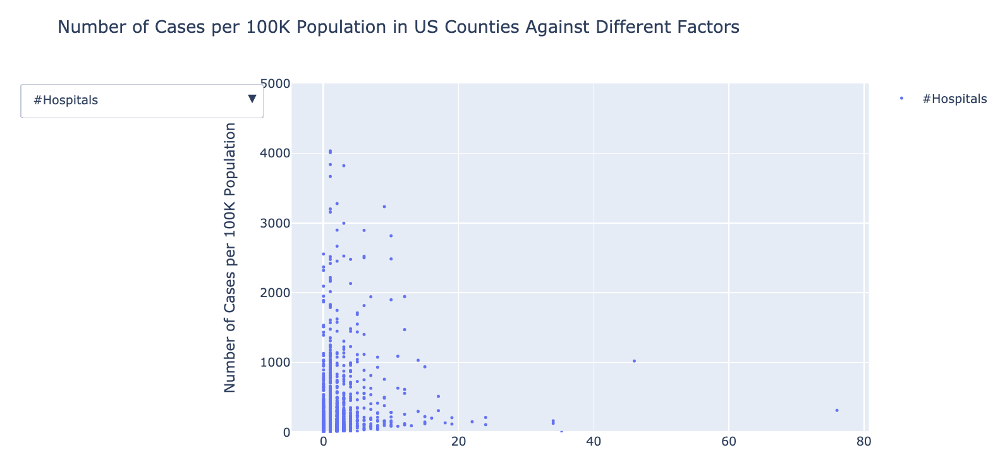

In [25]:
Image("hospitals_cases.png")

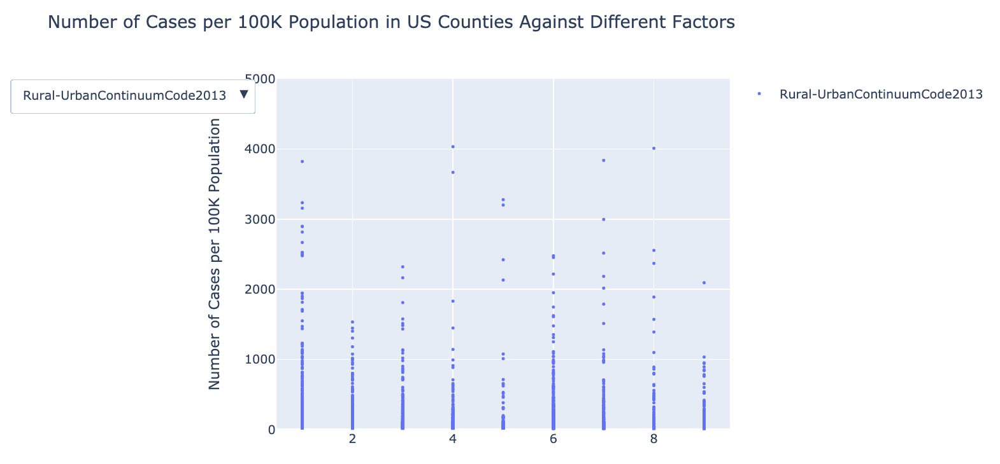

In [26]:
Image("rural_urban_cases.png")

From the plots, we observe that urban areas tend to have a higher number of cases, the number of hospitals and ICU beds are somewhat correlated to the number of cases, population factors are more strongly correlated to the number of cases, and health risk factors do not seem to be correlated with the number of cases. We can use this analysis to guide feature selection for our model. 

In [27]:
counties = counties.drop(["CasesPer100k"], axis = 1)

### Feature Engineering

In [28]:
# Our input data will include the population and health risk factors and confirmed case data from x number of days ago
# Note: changing this variable may requiring updating the time_series data set. 
todaydate = '5/1/20'

#using data from 1 month back
dates_series = ['5/1/20', '5/4/20', '5/7/20', '5/10/20']

counties.columns = counties.columns[:27].tolist() + pd.to_datetime(counties.columns[27:], infer_datetime_format=True).tolist()
model_data = pd.melt(counties, counties.columns[:27], 
                     counties[[pd.to_datetime(x ,infer_datetime_format=True) for x in dates_series]].columns)
# model_data = pd.melt(counties, counties.columns[:26], 
#                      list(counties.loc[:, pd.to_datetime('5/1/20',infer_datetime_format=True):].columns))
model_data.drop('value', axis = 1, inplace = True)
print(model_data.shape)
model_data.head()

(12560, 28)


,countyFIPS,CountyName,StateAbbrev,Rural-UrbanContinuumCode2013,PopulationEstimate65+2017,PopulationDensityperSqMile2010,#ICU_beds,#Hospitals,HeartDiseaseMortality,StrokeMortality,...,percent_adults_with_obesity,food_environment_index,num_primary_care_physicians,preventable_hospitalization_rate,percent_vaccinated,percent_children_in_poverty,overcrowding,percent_food_insecure,num_rural,variable
0,01001,Autauga,AL,2.0,8392.0,91.8,6.0,1.0,204.5,56.1,...,33.3,7.2,25.0,7108.0,41.0,19.3,1.201923,13.2,22921.0,2020-05-01
1,01003,Baldwin,AL,3.0,42413.0,114.7,51.0,3.0,183.2,41.9,...,31.0,8.0,155.0,4041.0,44.0,13.9,1.270792,11.6,77060.0,2020-05-01
2,01005,Barbour,AL,6.0,4757.0,31.0,5.0,1.0,220.4,49.0,...,41.7,5.6,8.0,6209.0,37.0,43.9,1.688596,22.0,18613.0,2020-05-01
3,01007,Bibb,AL,1.0,3632.0,36.8,0.0,1.0,225.5,57.2,...,37.6,7.8,11.0,5961.0,38.0,27.8,0.255319,14.3,15663.0,2020-05-01
4,01009,Blount,AL,1.0,10351.0,88.9,6.0,1.0,224.8,52.8,...,33.8,8.4,13.0,4060.0,39.0,18.0,1.891368,10.7,51562.0,2020-05-01


In [29]:
#using data from 1 month back. First create columns with the same date in each row. 
for i in [30, 29, 28]:
    date = model_data['variable'] - timedelta(i)
    model_data[str(i) + "_days_ago"] = date.reset_index(level=0, drop=True)
    
# Output date is our prediction column. 
model_data.rename({'variable':'output_date'}, axis=1, inplace=True)
print(model_data.shape)
model_data.head()

(12560, 31)


,countyFIPS,CountyName,StateAbbrev,Rural-UrbanContinuumCode2013,PopulationEstimate65+2017,PopulationDensityperSqMile2010,#ICU_beds,#Hospitals,HeartDiseaseMortality,StrokeMortality,...,preventable_hospitalization_rate,percent_vaccinated,percent_children_in_poverty,overcrowding,percent_food_insecure,num_rural,output_date,30_days_ago,29_days_ago,28_days_ago
0,01001,Autauga,AL,2.0,8392.0,91.8,6.0,1.0,204.5,56.1,...,7108.0,41.0,19.3,1.201923,13.2,22921.0,2020-05-01,2020-04-01,2020-04-02,2020-04-03
1,01003,Baldwin,AL,3.0,42413.0,114.7,51.0,3.0,183.2,41.9,...,4041.0,44.0,13.9,1.270792,11.6,77060.0,2020-05-01,2020-04-01,2020-04-02,2020-04-03
2,01005,Barbour,AL,6.0,4757.0,31.0,5.0,1.0,220.4,49.0,...,6209.0,37.0,43.9,1.688596,22.0,18613.0,2020-05-01,2020-04-01,2020-04-02,2020-04-03
3,01007,Bibb,AL,1.0,3632.0,36.8,0.0,1.0,225.5,57.2,...,5961.0,38.0,27.8,0.255319,14.3,15663.0,2020-05-01,2020-04-01,2020-04-02,2020-04-03
4,01009,Blount,AL,1.0,10351.0,88.9,6.0,1.0,224.8,52.8,...,4060.0,39.0,18.0,1.891368,10.7,51562.0,2020-05-01,2020-04-01,2020-04-02,2020-04-03


In [30]:
#set date columns to values of confirmed cases per 100K
counties_fips_index = counties.set_index('countyFIPS')

# Replace dates with cases per 100K on that day. This may take a bit to run.
for i in ['30_days_ago', '29_days_ago', '28_days_ago']:
    def replacedates(df_line):
        fips = df_line['countyFIPS']
        date = df_line[i]
        #return counties_fips_index.loc[fips, date] 
        return counties_fips_index.loc[fips, date] * 100000 / df_line['population'] 
    model_data[i] = model_data.apply(replacedates, axis=1)
    

# Replace output date with cases per 100K on that date
def get_out(df_line):
    fips = df_line['countyFIPS']
    date = df_line['output_date']
    #return counties_fips_index.loc[fips, date]
    return counties_fips_index.loc[fips, date] * 100000 / df_line['population']
model_data['output_date'] = model_data.apply(get_out, axis=1)

# Reorder columns to put prediction column at the end

temp = model_data['output_date']
model_data.drop('output_date', axis=1, inplace=True)
model_data['output_date'] = temp

In [31]:
# Find counties with inconsistent reporting
model_data[(model_data["28_days_ago"] < model_data["29_days_ago"]) | (model_data["29_days_ago"] < model_data["30_days_ago"])]

,countyFIPS,CountyName,StateAbbrev,Rural-UrbanContinuumCode2013,PopulationEstimate65+2017,PopulationDensityperSqMile2010,#ICU_beds,#Hospitals,HeartDiseaseMortality,StrokeMortality,...,preventable_hospitalization_rate,percent_vaccinated,percent_children_in_poverty,overcrowding,percent_food_insecure,num_rural,30_days_ago,29_days_ago,28_days_ago,output_date
2810,51001,Accomack,VA,8.0,7402.0,73.8,10.0,1.0,218.3,38.7,...,4264.0,44.0,27.0,2.098408,14.1,33164.0,21.661097,30.944424,24.755539,937.616042
2846,51075,Goochland,VA,1.0,4896.0,77.2,0.0,0.0,147.7,39.6,...,3465.0,54.0,7.9,1.223242,6.9,21064.0,29.469962,37.889951,33.679956,328.379573
2865,51113,Madison,VA,8.0,2885.0,41.5,0.0,0.0,153.4,36.8,...,4771.0,58.0,16.1,3.075397,9.0,13308.0,22.622728,22.622728,15.081819,105.572732
2895,51179,Stafford,VA,1.0,14782.0,479.5,4.0,1.0,131.8,35.4,...,5741.0,44.0,6.5,1.094561,6.3,25476.0,18.314779,17.660679,18.968878,164.178909
6028,51165,Rockingham,VA,3.0,14933.0,89.9,0.0,0.0,131.0,38.4,...,5730.0,48.0,9.3,1.773465,7.8,45279.0,18.304291,19.524577,18.304291,328.256943
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12278,51099,King George,VA,6.0,3363.0,131.3,0.0,0.0,126.4,34.5,...,6073.0,37.0,9.1,0.922722,8.1,17261.0,52.168729,48.442391,52.168729,152.779848
12291,51127,New Kent,VA,1.0,3648.0,87.9,0.0,0.0,160.4,37.2,...,3929.0,50.0,7.3,1.526211,6.9,18429.0,56.298991,51.968299,51.968299,112.597982
12295,51137,Orange,VA,6.0,7305.0,98.3,0.0,0.0,143.9,33.9,...,4303.0,53.0,12.9,2.906757,8.6,19345.0,37.785755,35.086772,35.086772,124.153194
12302,51153,Prince William,VA,1.0,43886.0,1195.0,24.0,2.0,115.2,35.3,...,5131.0,47.0,8.7,3.385228,5.8,16748.0,71.651057,82.919621,82.707007,582.563492


In [32]:
# Remove any counties with inconsistent reporting
print(model_data.shape)
model_data = model_data[(model_data["28_days_ago"] >= model_data["29_days_ago"]) & (model_data["29_days_ago"] >= model_data["30_days_ago"])]
model_data.shape

(12560, 31)


(12437, 31)

In [33]:
# Select relevant columns based on initial EDA

columns = [
         #'Rural-UrbanContinuumCode2013',
         '#Hospitals',
         '#ICU_beds',
         #'HeartDiseaseMortality',
         #'StrokeMortality',
         #'RespMortalityRate2014',
         #'DiabetesPercentage',
         'PopulationEstimate65+2017', 
         #'population',
         #'years_of_potential_life_lost_rate',
         #'percent_fair_or_poor_health',
         #'percent_low_birthweight',
         #'percent_smokers',
         #'percent_adults_with_obesity',
         #'food_environment_index',
         'num_primary_care_physicians',
         #'preventable_hospitalization_rate',
         #'percent_vaccinated',
         #'percent_children_in_poverty',
         'overcrowding',
         #'percent_food_insecure',
         #'num_rural',
         '30_days_ago',
         '29_days_ago',
         '28_days_ago']
without_id = model_data.drop(['countyFIPS', 'CountyName', 'StateAbbrev'], axis=1)
selected = without_id[columns]
selected

,#Hospitals,#ICU_beds,PopulationEstimate65+2017,num_primary_care_physicians,overcrowding,30_days_ago,29_days_ago,28_days_ago
0,1.0,6.0,8392.0,25.0,1.201923,17.899014,17.899014,21.478817
1,3.0,51.0,42413.0,155.0,1.270792,10.303090,11.199011,12.542892
2,1.0,5.0,4757.0,8.0,1.688596,0.000000,0.000000,4.050879
3,1.0,0.0,3632.0,11.0,0.255319,13.396445,17.861927,17.861927
4,1.0,6.0,10351.0,13.0,1.891368,8.646630,10.375955,15.563933
...,...,...,...,...,...,...,...,...
12555,1.0,0.0,605.0,6.0,2.591093,61.236987,61.236987,61.236987
12556,0.0,0.0,1020.0,5.0,5.739514,0.000000,16.121232,16.121232
12557,0.0,0.0,171.0,0.0,3.720930,0.000000,0.000000,0.000000
12558,1.0,0.0,564.0,3.0,2.105263,0.000000,0.000000,0.000000


### Model Development

#### Regular Linear Regression

In [34]:
x = selected
y = without_id['output_date']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.25, random_state=42)

In [35]:
linear_model = lm.LinearRegression()
linear_model.fit(x_train, y_train)

def rmse(model, x, y):
    return np.sqrt(np.mean((y - model.predict(x)) ** 2))

trained = linear_model.predict(x_train)
train_error = rmse(linear_model, x_train, y_train)
print("Training RMSE:", train_error)

score = cross_val_score(linear_model, x_train, y_train, scoring=rmse, cv=5)
validation_error = np.mean(score)

print("Validation RMSE:", validation_error)

#saving for future plot
linear_hand_selected = linear_model
linear_model_hand_selected_training_error = train_error
linear_model_hand_selected_validation_error = validation_error

Training RMSE: 346.740828149691
Validation RMSE: 341.987350510349


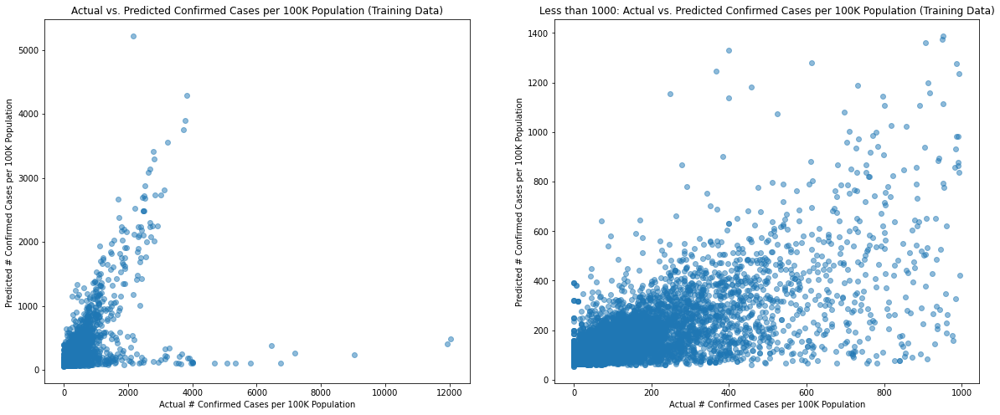

In [36]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))

y_pred = linear_model.predict(x_train)
ax1.scatter(y_train, y_pred, alpha=0.5)
ax1.set_xlabel("Actual # Confirmed Cases per 100K Population")
ax1.set_ylabel("Predicted # Confirmed Cases per 100K Population ")
ax1.set_title("Actual vs. Predicted Confirmed Cases per 100K Population (Training Data)");

ax2.scatter(y_train[y_train < 1000], y_pred[y_train < 1000], alpha=0.5)
ax2.set_xlabel("Actual # Confirmed Cases per 100K Population")
ax2.set_ylabel("Predicted # Confirmed Cases per 100K Population")
ax2.set_title("Less than 1000: Actual vs. Predicted Confirmed Cases per 100K Population (Training Data)");

We can see that the model undershoots predictions more often than it overshoots for cases per 100K population. This is likely because we used a linear combination for the number of cases 30 days ago to create our model. Another issue may be that we some counties only started testing recently, and didn't have an accurate number of cases counted a month ago to allow for accurate prediction. As a result, the model frequently predicts lower values. 

Our initial model predicted number of cases rather than cases per 100K, and we found very strong correlation. This was likely because counties that had a large number of cases a month ago, were also likely have a large number of cases today. For this reason, we decided to switch to predicting cases per 100K population.

Next, we were curious why there were several points with greater than 4000K cases per every 100K, and filtered out these counties. 

In [37]:
model_data[model_data['output_date'] > 4000].groupby(["countyFIPS","CountyName", "StateAbbrev"]).agg('mean').iloc[:,23:]


,,,num_rural,30_days_ago,29_days_ago,28_days_ago,output_date
countyFIPS,CountyName,StateAbbrev,,,,,
05079,Lincoln,AR,14134.0,56.306306,58.865684,69.103194,6639.025389
27105,Nobles,MN,8762.0,0.000000,0.000000,0.000000,4952.841093
31043,Dakota,NE,4430.0,0.000000,0.000000,0.000000,5497.852791
47007,Bledsoe,TN,12876.0,19.915029,19.915029,19.915029,4009.559214
47169,Trousdale,TN,7870.0,88.621056,99.698688,112.991847,11254.874158


There are certain counties that have much larger cases per 100K population (listed above). The county with the highest, Trousdale, TN, had 1,363 cases, with 1299 being inmates in a prison located in the county, and another 50 being prison workers. More information can be found here:

https://fox17.com/news/local/tennessee-county-leads-us-in-virus-cases-per-capita 

In [38]:
linear_model.coef_

array([-2.12463689e-01,  3.15276828e-02, -3.68455792e-04,  6.72592197e-02,
        8.69673809e+00, -2.59319102e+00, -4.06386359e+00,  8.08578321e+00])

In [39]:
linear_model.intercept_

61.08085846588952

The coefficients reveal that the model places the heaviest emphasis on the count of cases per 100K for the three days provided. It also placed a suprising heavy emphasis on overcrowding within counties. 

#### Lasso Linear Regression Model

When using either data from a week ago or data from a month ago, we can see that the last three features (previous confirmed counts) are the most important. However, we see drops in the RMSE after the incorporation of some other features.

In this section, we use the Lasso model to determine which features are most important, and create a new model based on these features.

In [40]:
#we use all the features in our Lasso model to see which ones it selects for
selected = without_id.drop(["output_date"], axis=1)

x = selected
y = without_id['output_date']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.25, random_state=42)

I kept getting convergence warnings when running Lasso with max_iter < 100000, which is why I set the variable above. However, running cross validation on a range of alpha values was taking way too long so, I ran it normally.

In [41]:
#when trying to run the model to find the best alpha, increasing the number of max_iterations still didn't converge
#we decided to train the model without that parameter to save computation time

alpha = np.linspace(0.02, 5, 60)
cv_errors = []

for a in alpha:
    model = Lasso(alpha=a)
    cv_error = np.mean(cross_val_score(model, x_train, y_train, scoring = rmse, cv=5))
    cv_errors.append(cv_error)
    
best_alpha = alpha[np.argmin(cv_errors)]

print(f"The best alpha value is {best_alpha}")
print(f"Cross validation error for the best alpha value is {cv_errors[np.argmin(cv_errors)]}")

lasso_model_validation_error = cv_errors[np.argmin(cv_errors)]

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 463316027.49473035, tolerance: 136590.14608511553

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 396609030.55165374, tolerance: 123132.85433158789

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 388411642.087507, tolerance: 121607.20567639139

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 488744462.6916255, tolerance: 145691.

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 445764771.3556849, tolerance: 145691.85588089225

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 418604765.37029415, tolerance: 137041.7792621937

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 451535762.124183, tolerance: 136590.14608511553

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 391808240.42600137, tolerance: 123132.8

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 369839962.15379846, tolerance: 121607.20567639139

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 403376642.9377983, tolerance: 145691.85588089225

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 387892674.39323, tolerance: 137041.7792621937

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 440382107.26925415, tolerance: 136590.14

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 382911645.24806976, tolerance: 123132.85433158789

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 359399219.1444854, tolerance: 121607.20567639139

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 366203426.52998734, tolerance: 145691.85588089225

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 358343199.64984393, tolerance: 13704

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 420000040.5923441, tolerance: 136590.14608511553

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 377472133.95932233, tolerance: 123132.85433158789

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 348512269.1751304, tolerance: 121607.20567639139

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 314493971.97341037, tolerance: 145691

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 310706471.9842255, tolerance: 137041.7792621937

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 409480416.99931157, tolerance: 136590.14608511553

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 372328525.4388994, tolerance: 123132.85433158789

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 337159369.9225417, tolerance: 121607.2

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 253340355.77162498, tolerance: 145691.85588089225

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 288927087.9094143, tolerance: 137041.7792621937

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 399205241.511719, tolerance: 136590.14608511553

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 367092898.29285693, tolerance: 123132.8

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 324835356.77346754, tolerance: 121607.20567639139

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 229348933.70283568, tolerance: 145691.85588089225

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 269119166.9173529, tolerance: 137041.7792621937

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 389170217.5781695, tolerance: 136590.

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 357502453.0208205, tolerance: 123132.85433158789

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 315525337.46346503, tolerance: 121607.20567639139

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 217799401.45129353, tolerance: 145691.85588089225

/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 251062014.21863434, tolerance: 13704

The best alpha value is 2.130169491525424
Cross validation error for the best alpha value is 338.50781675353204


/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 239101439.7885216, tolerance: 137041.7792621937



In [42]:
best_alpha

2.130169491525424

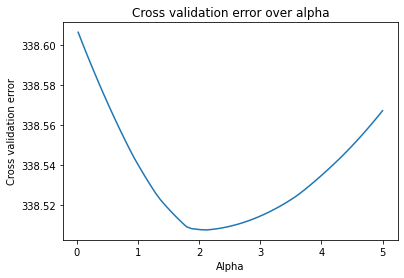

In [43]:
plt.plot(alpha, cv_errors)
plt.title('Cross validation error over alpha')
plt.xlabel('Alpha')
plt.ylabel('Cross validation error')
plt.show()

Didn't improve much from before running cross validation.

In [44]:
#when trying to rerun the model with the best alpha, increasing the number of max_iterations still didn't converge
#we decided to train the model without that parameter to save computation time

model.fit(x_train, y_train)
lasso_model_training_error = rmse(model, x_train, y_train)
print(lasso_model_training_error)

lasso_model = model

342.7063214526384


/usr/local/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations. Duality gap: 389184303.13866776, tolerance: 166020.35650216514



#### Linear Model with Lasso Selected Features

We see that RMSE error reduced slightly both in cross validation and training error. We were curious which features the Lasso model was selecting, and decided to make a linear model based on these features.

In [45]:
list(zip(model.coef_, selected))

[(-3.599622035003152, 'Rural-UrbanContinuumCode2013'),
 (-0.00020039943052390277, 'PopulationEstimate65+2017'),
 (0.004493627274284937, 'PopulationDensityperSqMile2010'),
 (-0.10156050105624369, '#ICU_beds'),
 (2.137996747075745, '#Hospitals'),
 (-0.053061248901167465, 'HeartDiseaseMortality'),
 (-0.8476827842438099, 'StrokeMortality'),
 (0.5618989012210405, 'RespMortalityRate2014'),
 (-0.19569231892611513, 'DiabetesPercentage'),
 (0.0, 'Smokers_Percentage'),
 (-1.7463111685241047e-05, 'population'),
 (-0.010573748070207107, 'years_of_potential_life_lost_rate'),
 (7.682107881576965, 'percent_fair_or_poor_health'),
 (3.91445374508145, 'percent_low_birthweight'),
 (0.0, 'percent_smokers'),
 (0.9579512643871426, 'percent_adults_with_obesity'),
 (0.0, 'food_environment_index'),
 (0.06786395470580682, 'num_primary_care_physicians'),
 (0.009604331216484267, 'preventable_hospitalization_rate'),
 (3.4332481717762104, 'percent_vaccinated'),
 (1.559914439597957, 'percent_children_in_poverty'),
 

In [46]:
selected_features = [x[1] for x in list(zip(model.coef_, selected)) if abs(x[0]) >= 0.1]
selected_features

['Rural-UrbanContinuumCode2013',
 '#ICU_beds',
 '#Hospitals',
 'StrokeMortality',
 'RespMortalityRate2014',
 'DiabetesPercentage',
 'percent_fair_or_poor_health',
 'percent_low_birthweight',
 'percent_adults_with_obesity',
 'percent_vaccinated',
 'percent_children_in_poverty',
 'overcrowding',
 'percent_food_insecure',
 '30_days_ago',
 '29_days_ago',
 '28_days_ago']

In [47]:
#rerunning our regular linear model with these selected features
x = without_id[selected_features]
y = without_id['output_date']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.25, random_state=42)

In [48]:
linear_model2 = lm.LinearRegression()
linear_model2.fit(x_train, y_train)

trained = linear_model2.predict(x_train)
train_error = rmse(linear_model2, x_train, y_train)
print("Training RMSE:", train_error)

score = cross_val_score(linear_model, x_train, y_train, scoring=rmse, cv=5)
validation_error = np.mean(score)

print("Validation RMSE:", validation_error)

#saving for future plot
linear_lasso_selected = linear_model2
linear_model_lasso_selected_training_error = train_error
linear_model_lasso_selected_validation_error = validation_error

Training RMSE: 343.84058181755375
Validation RMSE: 339.33136999070865


### Model Selection

In [49]:
models = ['linear_hand_selected', 'lasso', 'linear_lasso_selected']
training_errors = [linear_model_hand_selected_training_error, lasso_model_training_error, linear_model_lasso_selected_training_error]
validation_errors = [linear_model_hand_selected_validation_error, lasso_model_validation_error, linear_model_lasso_selected_validation_error]

fig = go.Figure([
        go.Bar(x = models, y = training_errors, name="Training RMSE"),
        go.Bar(x = models, y = validation_errors, name="CV RMSE")])

fig.update_layout(
    title = 'Training and Validation Errors for Three Models',
    xaxis_title = 'Model',
    yaxis_title = 'RMSE Error'
)

fig.show()

fig_zoomed = go.Figure([
        go.Bar(x = models, y = training_errors, name="Training RMSE"),
        go.Bar(x = models, y = validation_errors, name="CV RMSE")])

fig_zoomed.update_layout(
    title = 'Training and Validation Errors for Three Models Zoomed',
    yaxis = {'range':[330, 350]},
    xaxis_title = 'Model',
    yaxis_title = 'RMSE Error'
)

fig_zoomed.show()

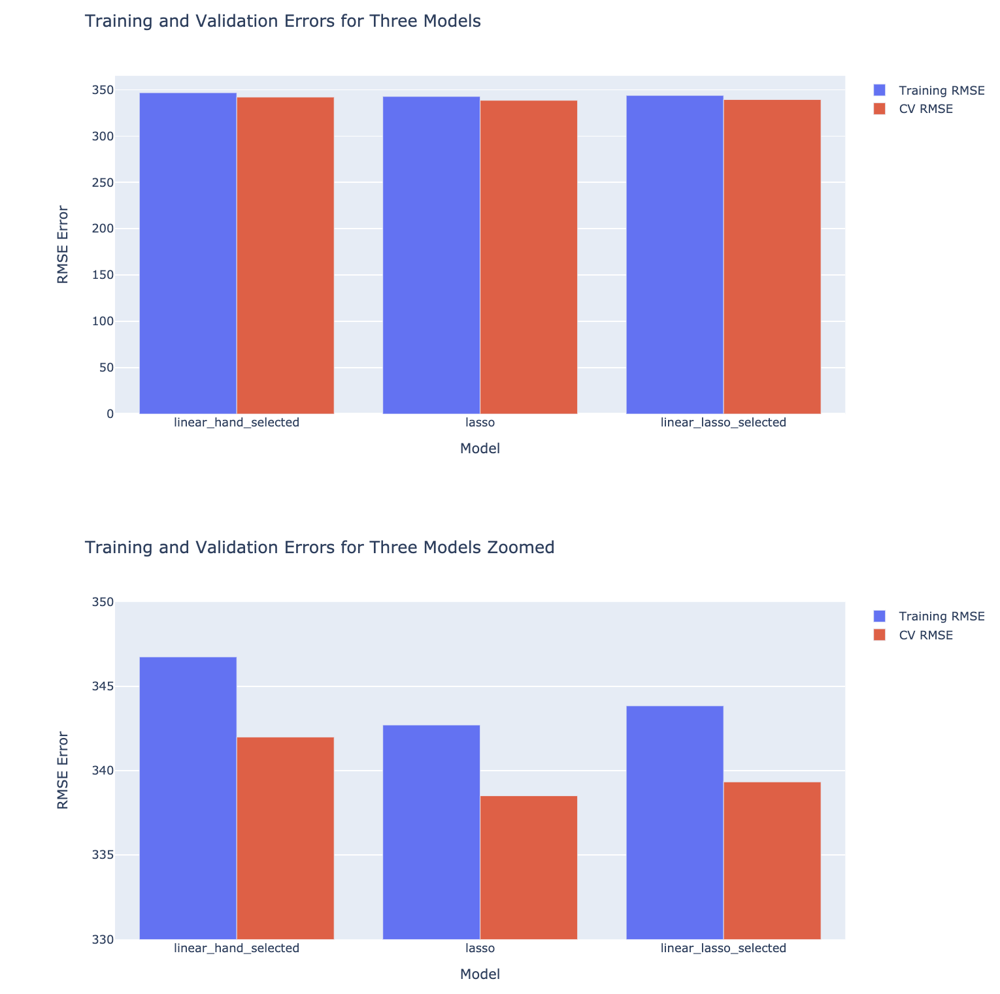

In [50]:
Image("RMSEs.png")

We use the lasso model on our training data because it shows the lowest validation and training error. 

In [51]:
selected = without_id.drop(["output_date"], axis=1)

x = selected
y = without_id['output_date']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.25, random_state=42)

y_pred = lasso_model.predict(x_test)
error = rmse(lasso_model, x_test, y_test)

error

334.8990350676028

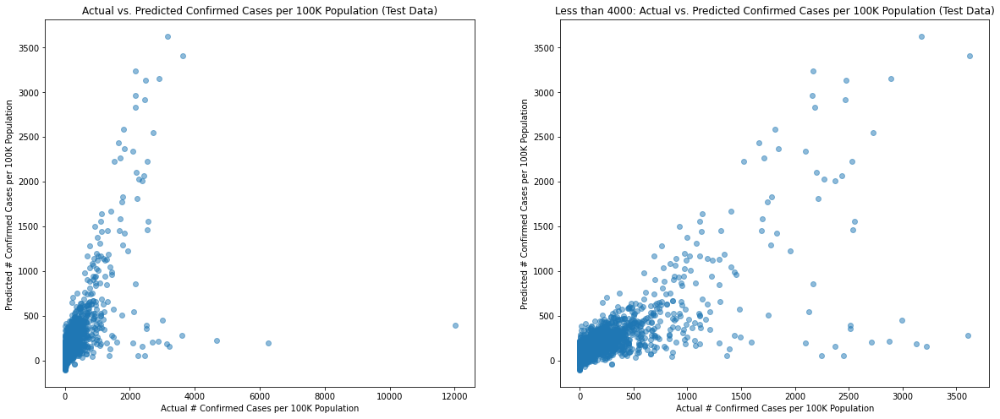

In [52]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))

ax1.scatter(y_test, y_pred, alpha=0.5)
ax1.set_xlabel("Actual # Confirmed Cases per 100K Population")
ax1.set_ylabel("Predicted # Confirmed Cases per 100K Population ")
ax1.set_title("Actual vs. Predicted Confirmed Cases per 100K Population (Test Data)");

ax2.scatter(y_test[y_test < 4000], y_pred[y_test < 4000], alpha=0.5)
ax2.set_xlabel("Actual # Confirmed Cases per 100K Population")
ax2.set_ylabel("Predicted # Confirmed Cases per 100K Population")
ax2.set_title("Less than 4000: Actual vs. Predicted Confirmed Cases per 100K Population (Test Data)");

Similarly to before, we see that our model still underpredicts the number of cases today based on data points from 3 months ago. Again, this is partially because there may not have been full testing available one month ago in many counties. 

### Predicting Future Cases Using Selected Model

In [53]:
#predicting for June 1

test_data = counties.copy()
date_cols = pd.to_datetime(['5/1/20', '5/2/20', '5/3/20'], infer_datetime_format=True).tolist()
test_data = test_data[test_data.iloc[:, :27].columns.tolist() + date_cols]
for col in date_cols:
    test_data[col] = 100000 * test_data[col]/test_data["population"]
test_data.rename({date_cols[0]:'5/1/20', date_cols[1]:'5/2/20', date_cols[2]:'5/3/20'}, axis=1, inplace=True)

test_data

,countyFIPS,CountyName,StateAbbrev,Rural-UrbanContinuumCode2013,PopulationEstimate65+2017,PopulationDensityperSqMile2010,#ICU_beds,#Hospitals,HeartDiseaseMortality,StrokeMortality,...,num_primary_care_physicians,preventable_hospitalization_rate,percent_vaccinated,percent_children_in_poverty,overcrowding,percent_food_insecure,num_rural,5/1/20,5/2/20,5/3/20
0,01001,Autauga,AL,2.0,8392.0,91.8,6.0,1.0,204.50,56.100000,...,25.0,7108.000000,41.000000,19.300,1.201923,13.2,22921.000000,75.175858,80.545562,85.915266
1,01003,Baldwin,AL,3.0,42413.0,114.7,51.0,3.0,183.20,41.900000,...,155.0,4041.000000,44.000000,13.900,1.270792,11.6,77060.000000,78.393076,81.080839,83.768602
2,01005,Barbour,AL,6.0,4757.0,31.0,5.0,1.0,220.40,49.000000,...,8.0,6209.000000,37.000000,43.900,1.688596,22.0,18613.000000,170.136920,174.187799,182.289557
3,01007,Bibb,AL,1.0,3632.0,36.8,0.0,1.0,225.50,57.200000,...,11.0,5961.000000,38.000000,27.800,0.255319,14.3,15663.000000,187.550237,187.550237,187.550237
4,01009,Blount,AL,1.0,10351.0,88.9,6.0,1.0,224.80,52.800000,...,13.0,4060.000000,39.000000,18.000,1.891368,10.7,51562.000000,67.443710,69.173036,69.173036
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3135,02195,Petersburg Borough,AK,9.0,605.0,1.2,0.0,1.0,159.25,37.659091,...,6.0,2974.133333,28.933333,9.500,2.591093,12.6,9522.521739,122.473974,122.473974,122.473974
3136,02198,Prince of Wales-Hyder Census Area,AK,9.0,1020.0,1.4,0.0,0.0,159.25,37.659091,...,5.0,2974.133333,28.933333,23.400,5.739514,16.5,9522.521739,32.242463,32.242463,32.242463
3137,02230,Skagway Municipality,AK,9.0,171.0,2.1,0.0,0.0,159.25,37.659091,...,0.0,2297.000000,24.000000,8.900,3.720930,14.4,9522.521739,0.000000,0.000000,0.000000
3138,02275,Wrangell City and Borough,AK,9.0,564.0,0.9,0.0,1.0,159.25,37.659091,...,3.0,2974.133333,28.933333,16.000,2.105263,14.0,9522.521739,0.000000,0.000000,0.000000


In [54]:
# Remove any counties with inconsistent reporting. We see that counties no longer have inconsistent reporting. 
print(test_data.shape)
test_data = test_data[(test_data['5/3/20'] >= test_data['5/2/20']) & (test_data['5/2/20'] >= test_data['5/1/20'])]
test_data.shape

(3140, 30)


(3140, 30)

In [55]:
without_id_test = test_data.iloc[:, 3:]

test_data['june1_pred'] = lasso_model.predict(without_id_test)
test_data

,countyFIPS,CountyName,StateAbbrev,Rural-UrbanContinuumCode2013,PopulationEstimate65+2017,PopulationDensityperSqMile2010,#ICU_beds,#Hospitals,HeartDiseaseMortality,StrokeMortality,...,preventable_hospitalization_rate,percent_vaccinated,percent_children_in_poverty,overcrowding,percent_food_insecure,num_rural,5/1/20,5/2/20,5/3/20,june1_pred
0,01001,Autauga,AL,2.0,8392.0,91.8,6.0,1.0,204.50,56.100000,...,7108.000000,41.000000,19.300,1.201923,13.2,22921.000000,75.175858,80.545562,85.915266,290.107509
1,01003,Baldwin,AL,3.0,42413.0,114.7,51.0,3.0,183.20,41.900000,...,4041.000000,44.000000,13.900,1.270792,11.6,77060.000000,78.393076,81.080839,83.768602,159.923966
2,01005,Barbour,AL,6.0,4757.0,31.0,5.0,1.0,220.40,49.000000,...,6209.000000,37.000000,43.900,1.688596,22.0,18613.000000,170.136920,174.187799,182.289557,459.673116
3,01007,Bibb,AL,1.0,3632.0,36.8,0.0,1.0,225.50,57.200000,...,5961.000000,38.000000,27.800,0.255319,14.3,15663.000000,187.550237,187.550237,187.550237,333.128591
4,01009,Blount,AL,1.0,10351.0,88.9,6.0,1.0,224.80,52.800000,...,4060.000000,39.000000,18.000,1.891368,10.7,51562.000000,67.443710,69.173036,69.173036,149.789101
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3135,02195,Petersburg Borough,AK,9.0,605.0,1.2,0.0,1.0,159.25,37.659091,...,2974.133333,28.933333,9.500,2.591093,12.6,9522.521739,122.473974,122.473974,122.473974,98.653822
3136,02198,Prince of Wales-Hyder Census Area,AK,9.0,1020.0,1.4,0.0,0.0,159.25,37.659091,...,2974.133333,28.933333,23.400,5.739514,16.5,9522.521739,32.242463,32.242463,32.242463,23.777848
3137,02230,Skagway Municipality,AK,9.0,171.0,2.1,0.0,0.0,159.25,37.659091,...,2297.000000,24.000000,8.900,3.720930,14.4,9522.521739,0.000000,0.000000,0.000000,-106.528794
3138,02275,Wrangell City and Borough,AK,9.0,564.0,0.9,0.0,1.0,159.25,37.659091,...,2974.133333,28.933333,16.000,2.105263,14.0,9522.521739,0.000000,0.000000,0.000000,-34.550181


In [56]:
test_data[test_data["StateAbbrev"] == "CA"][["CountyName", "StateAbbrev", "5/1/20", "5/2/20", "5/3/20", "june1_pred"]]

,CountyName,StateAbbrev,5/1/20,5/2/20,5/3/20,june1_pred
180,Alameda,CA,97.886173,102.014624,104.647260,331.603554
181,Alpine,CA,177.147919,177.147919,177.147919,260.666041
182,Amador,CA,20.124774,20.124774,20.124774,67.279368
183,Butte,CA,7.299736,7.299736,7.299736,47.332509
184,Calaveras,CA,28.319355,28.319355,28.319355,28.087753
185,Colusa,CA,13.923052,13.923052,13.923052,173.609243
186,Contra Costa,CA,78.628483,80.969133,81.922731,250.223935
187,Del Norte,CA,10.786711,10.786711,10.786711,59.063093
188,El Dorado,CA,24.372158,24.372158,24.372158,51.271917
189,Fresno,CA,61.555338,63.356958,63.356958,211.514437


The tables above show predictions for June 1st based on our selected Lasso model, first for all counties, then looking specifically within California. We see that for some counties that have low reported cases, our model predicts negative values, which is not possible. We believe these numbers will also be affected by how shelter in place regulations and other rules over the next month.

<a id='A-Global-View'></a>

## A Global View: Predicting Growth of Number of Cases in Different Countries

Shifting our focus to a broader global scale, wanted to predict how the number of cases would change into the future. Fitting a logistic curve, we were able to the predict number of cases in world countries a week into the future. This information would help countries that are still at the beginning of their curve understand how to best prepare for the pandemic. 

We tried fitting a linear model based on the parameters of the logistic curve for each country, which can be found in the Appendix as well. 

### Initial Exploratory Data Analysis

Here, we visualized the number of cases overtime in the world's largest countries. Some data was only recorded intermittently, so to include it, we have to remove perform smoothing to remove 0 values. 

From an initial glance, it seems as though the mortality rates are higher in Spain, Italy, the UK, and France compared to the United States. 

In [57]:
url = "https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_deaths_global.csv"
time_series_covid19_deaths_global = pd.read_csv(url)

url = "https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv"
time_series_covid19_confirmed_global = pd.read_csv(url)

Text(0.5, 0, 'Date')

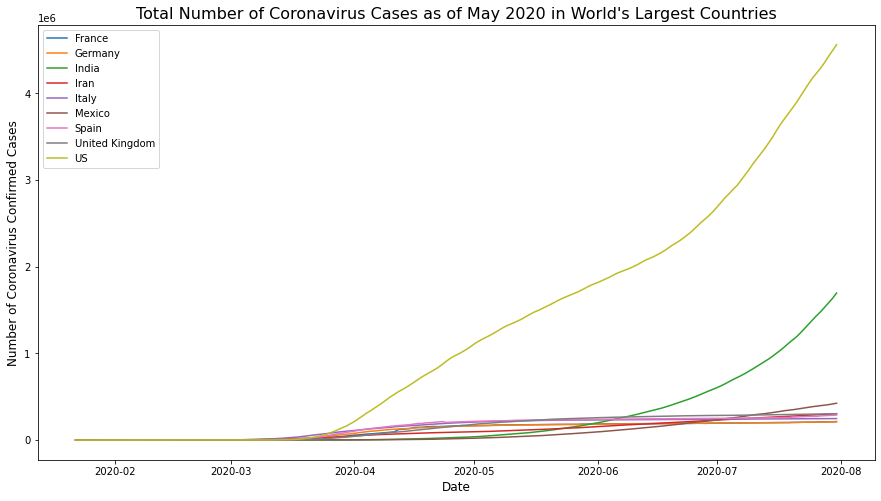

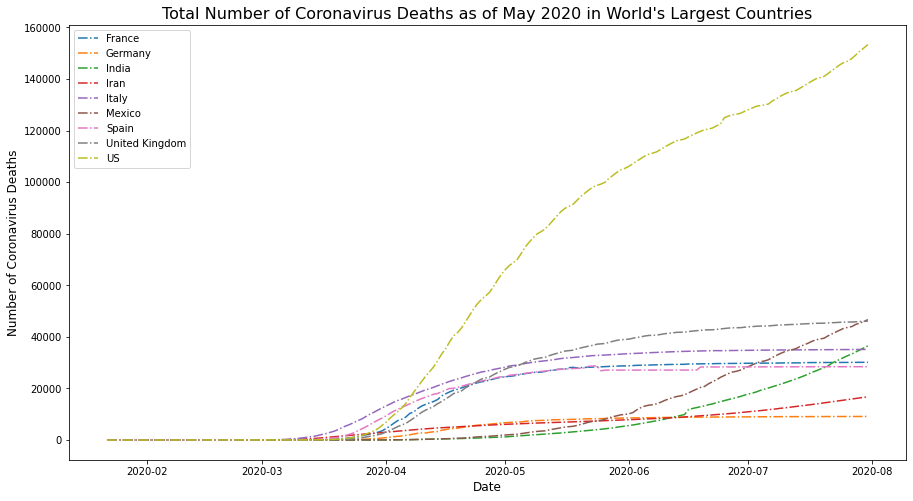

In [58]:
countries_to_include = ["US", "Mexico", "Italy", "India", "Spain", "Germany", "Iran", "China", "Canada", "United Kingdom", "France"]

# Data for Coronavirus Cases - Removing Province Data, this was causing mismatched patterns in the overall plot.
# Choosing countries to include and moving dates to row entries. 
cases_data = time_series_covid19_confirmed_global
cases_data = cases_data[(cases_data["Province/State"].isna()) & (cases_data["Country/Region"].isin(countries_to_include))]
cases_data = cases_data.drop(["Province/State", "Lat", "Long"], axis = 1)
cases_data = cases_data.melt(id_vars=["Country/Region"], var_name="Date", value_name="Value")
cases_data['Date'] = pd.to_datetime(cases_data['Date'])

# Plotting Coronavirus Cases
plt.figure(figsize=(15,8)) 
for country in cases_data["Country/Region"].unique():
    c_cases = cases_data[cases_data["Country/Region"] == country]
    plt.plot(c_cases['Date'], c_cases["Value"], label = country)
plt.legend()
plt.title("Total Number of Coronavirus Cases as of May 2020 in World's Largest Countries", size = 16)
plt.ylabel("Number of Coronavirus Confirmed Cases", size = 12)
plt.xlabel("Date", size = 12)

# Data Cleaning for Coronavirus Deaths - Removing Province Data, this was causing mismatched patterns in the overall plot.
# Choosing countries to include and moving dates to row entries. 
deaths_data = time_series_covid19_deaths_global
deaths_data = deaths_data[(deaths_data["Province/State"].isna()) & (deaths_data["Country/Region"].isin(countries_to_include))]
deaths_data = deaths_data.drop(["Province/State", "Lat", "Long"], axis = 1)
deaths_data = deaths_data.melt(id_vars=["Country/Region"], var_name="Date", value_name="Value")
deaths_data['Date'] = pd.to_datetime(deaths_data['Date'])

# Plotting Coronavirus Deaths
plt.figure(figsize=(15,8)) 
for country in deaths_data["Country/Region"].unique():
    c_deaths = deaths_data[deaths_data["Country/Region"] == country]
    plt.plot(c_deaths['Date'], c_deaths["Value"], label = country, linestyle='dashdot')
plt.legend()
plt.title("Total Number of Coronavirus Deaths as of May 2020 in World's Largest Countries", size = 16)
plt.ylabel("Number of Coronavirus Deaths", size = 12)
plt.xlabel("Date", size = 12)

### Data Cleaning

We first grouped data by country, rather than provinces/states within countries.

In [59]:
time_series_covid19_confirmed_global = time_series_covid19_confirmed_global.groupby(['Country/Region']).sum()
time_series_covid19_confirmed_global = time_series_covid19_confirmed_global.reset_index()
time_series_covid19_confirmed_global

,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,...,7/22/20,7/23/20,7/24/20,7/25/20,7/26/20,7/27/20,7/28/20,7/29/20,7/30/20,7/31/20
0,Afghanistan,33.939110,67.709953,0,0,0,0,0,0,0,...,35727,35928,35981,36036,36157,36263,36368,36471,36542,36675
1,Albania,41.153300,20.168300,0,0,0,0,0,0,0,...,4358,4466,4570,4637,4763,4880,4997,5105,5197,5276
2,Algeria,28.033900,1.659600,0,0,0,0,0,0,0,...,24872,25484,26159,26764,27357,27973,28615,29229,29831,30394
3,Andorra,42.506300,1.521800,0,0,0,0,0,0,0,...,889,889,897,897,897,907,907,918,922,925
4,Angola,-11.202700,17.873900,0,0,0,0,0,0,0,...,812,851,880,916,932,950,1000,1078,1109,1148
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183,West Bank and Gaza,31.952200,35.233200,0,0,0,0,0,0,0,...,9398,9744,10093,10306,10469,10621,10938,11284,11548,11837
184,Western Sahara,24.215500,-12.885800,0,0,0,0,0,0,0,...,10,10,10,10,10,10,10,10,10,10
185,Yemen,15.552727,48.516388,0,0,0,0,0,0,0,...,1640,1654,1674,1674,1681,1691,1703,1711,1726,1728
186,Zambia,-13.133897,27.849332,0,0,0,0,0,0,0,...,3583,3789,3856,4328,4481,4552,5002,5249,5555,5963


In [60]:
NUM_DAYS = len(time_series_covid19_confirmed_global.columns) - 3
time_series_covid19_confirmed_global.columns = ["Country", "Lat", "Long"] + [i for i in range(NUM_DAYS)]
from scipy import optimize

### Fitting the Data to a Logistic Curve to Make Predictions

Here, we fitted all of the countries in our dataset to a logistic model in order to identify where they are in the process of recovering from COVID-19. It is important to note that this logistic model fails to work for some countries due to overflow errors as they don't consistently report data, which are listed below the next block.

In [61]:
# logistic equation is L / (1 + e^(-k(x-x_0)))
def logistic_model(x, x_0, L, k):
    return L / (1.0 + np.exp(-k * (x - x_0)))

def rmse(val1, val2):
    return np.sqrt(np.mean((val1 - val2) ** 2))

def model_rmse(model, x, y):
    return np.sqrt(np.mean((y - model.predict(x)) ** 2))



x_vals = [i for i in range(NUM_DAYS)]
# store to plot later
all_y = {}
opt_params = {}
for r in time_series_covid19_confirmed_global.iterrows():
    #extract cases data from each row
    y_vals = [r[1][i] for i in range(NUM_DAYS)]
    all_y[r[1]['Country']] = y_vals   
    try:
        #curve is fit
        params, cov = optimize.curve_fit(logistic_model, x_vals, y_vals, p0 = [70, max(y_vals), 0.01])
        y_pred_ct = logistic_model(x_vals, params[0], params[1], params[2])
        params = list(params)
        params.append(rmse(np.array(y_vals), np.array(y_pred_ct)))
        params = np.array(params)
        opt_params[r[1]['Country']] = params
    except:
        print(r[1]['Country'])

Albania
Bahamas
Bosnia and Herzegovina
Bulgaria
Gambia
Israel
Kosovo
Lebanon
Libya
Montenegro
Papua New Guinea
Paraguay
Uzbekistan
Zambia
Zimbabwe


We created a DataFrame of parameter results to analyze the following:

- X_0: the midpoint of the sigmoid curve. This essentially tells us where each country's peak day since 1/22 is or will be.

- L: The curve's maximum value. This is our naive prediction of the number of cases inflicted on each country.

- k: Growth rate. The higher this value, the more quickly we know the number of cases rises.

In [62]:
opt_df = pd.DataFrame.from_dict(opt_params, orient='index')
opt_df.columns = ["x_0", "L", "k", "rmse"]
opt_df

,x_0,L,k,rmse
Afghanistan,134.496677,36476.790998,0.077790,192.101117
Algeria,255.496213,171571.835897,0.024324,933.698179
Andorra,72.036341,826.786816,0.126474,40.897888
Angola,272.422815,49505.375720,0.045674,11.513719
Antigua and Barbuda,272.384145,604.136072,0.020683,7.780596
...,...,...,...,...
Venezuela,209.253342,60149.670996,0.045618,110.461393
Vietnam,72.369545,362.562047,0.059269,32.638653
West Bank and Gaza,173.709721,13484.817337,0.105087,209.455706
Western Sahara,93.637954,9.835931,0.057480,0.958283


### Understanding the Model Through Visualizations

Plot of the logistic curve fit for China.

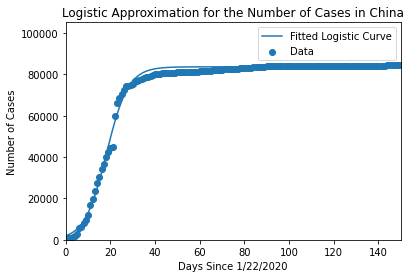

In [63]:
curve_x = [i for i in range(200)]
country_plt = 'China'
plt.scatter(x_vals, all_y[country_plt], label = 'Data')
y_pred = logistic_model(curve_x, opt_params[country_plt][0], opt_params[country_plt][1], opt_params[country_plt][2])
plt.plot(curve_x, y_pred, 
        label = 'Fitted Logistic Curve')
plt.legend(loc = 'best')
plt.title("Logistic Approximation for the Number of Cases in China")
plt.xlabel("Days Since 1/22/2020")
plt.ylabel("Number of Cases")
plt.xlim(0, 150)
plt.ylim(0, max(all_y[country_plt]) * 1.2)
plt.show()

Plots for Italy and India.

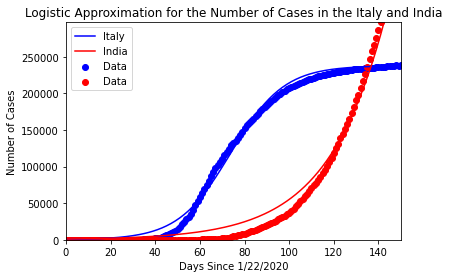

In [64]:
#Plot China
curve_x = [i for i in range(1, 200)]
country_plt = 'Italy'
plt.scatter(x_vals, all_y[country_plt], color = "blue", label = 'Data')
y_pred = logistic_model(curve_x, opt_params[country_plt][0], opt_params[country_plt][1], opt_params[country_plt][2])
plt.plot(curve_x, y_pred, 
        label = 'Italy', color = "blue")
plt.legend(loc = 'best')
plt.title("Logistic Approximation for the Number of Cases in the Italy and India")
plt.xlim(0, 150)

curve_x = [i for i in range(1, 200)]
country_plt1 = 'India'
plt.scatter(x_vals, all_y[country_plt1], color = "red", label = 'Data')
y_pred = logistic_model(curve_x, opt_params[country_plt1][0], opt_params[country_plt1][1], opt_params[country_plt1][2])
plt.plot(curve_x, y_pred, 
        label = 'India', color = "red")
plt.legend(loc = 'best')
plt.xlabel("Days Since 1/22/2020")
plt.ylabel("Number of Cases")
plt.xlim(0, 150)
plt.ylim(0, max(all_y[country_plt]) * 1.2)
plt.show()


In [65]:
opt_df.index.tolist()

['Afghanistan',
 'Algeria',
 'Andorra',
 'Angola',
 'Antigua and Barbuda',
 'Argentina',
 'Armenia',
 'Australia',
 'Austria',
 'Azerbaijan',
 'Bahrain',
 'Bangladesh',
 'Barbados',
 'Belarus',
 'Belgium',
 'Belize',
 'Benin',
 'Bhutan',
 'Bolivia',
 'Botswana',
 'Brazil',
 'Brunei',
 'Burkina Faso',
 'Burma',
 'Burundi',
 'Cabo Verde',
 'Cambodia',
 'Cameroon',
 'Canada',
 'Central African Republic',
 'Chad',
 'Chile',
 'China',
 'Colombia',
 'Comoros',
 'Congo (Brazzaville)',
 'Congo (Kinshasa)',
 'Costa Rica',
 "Cote d'Ivoire",
 'Croatia',
 'Cuba',
 'Cyprus',
 'Czechia',
 'Denmark',
 'Diamond Princess',
 'Djibouti',
 'Dominica',
 'Dominican Republic',
 'Ecuador',
 'Egypt',
 'El Salvador',
 'Equatorial Guinea',
 'Eritrea',
 'Estonia',
 'Eswatini',
 'Ethiopia',
 'Fiji',
 'Finland',
 'France',
 'Gabon',
 'Georgia',
 'Germany',
 'Ghana',
 'Greece',
 'Grenada',
 'Guatemala',
 'Guinea',
 'Guinea-Bissau',
 'Guyana',
 'Haiti',
 'Holy See',
 'Honduras',
 'Hungary',
 'Iceland',
 'India',
 'In

<a id='World-Predictions'></a>

In [66]:
#create plots with dropdown menus
from functools import reduce

#countries = ["US", "Mexico", "Italy", "India", "Spain", "Germany", "Iran", "China", "Canada", "United Kingdom", "France"]
countries = opt_df.index.tolist()

fig = go.Figure()

fig.update_layout(
        xaxis_title="Number of Days since 1/22/20",
        yaxis_title="Number of Cases",
        title = "Number of Cases in World Countries Over Time"
    )

for country in countries:
    
    curve_x = [i for i in range(1, 200)]
    y_pred = logistic_model(curve_x, opt_params[country][0], opt_params[country][1], opt_params[country][2])
    
    fig.add_trace(
        go.Scatter(
            x = x_vals,
            y = all_y[country],
            name = country + " Data",
            mode='markers',
            marker = {'size':5}
        )
    )
    
     
    fig.add_trace(
        go.Scatter(
            x = curve_x,
            y = y_pred,
            name = country + " Logistic Curve"
        )
    )

def create_layout_button(country):
    
    visible = ([True, True] if c == country else [False, False] for c in countries)
    visible = reduce(np.append, visible)
    
    return dict(label = country,
                method = 'update',
                args = [{'visible': visible,
                         'title': country,
                         'showlegend': True}])

fig.update_layout(
    updatemenus=[go.layout.Updatemenu(
        active = 0,
        buttons = list(map(lambda country: create_layout_button(country), countries)))
    ])

print("Please select a dropdown option to start the visualization.")
fig.show()

Please select a dropdown option to start the visualization.


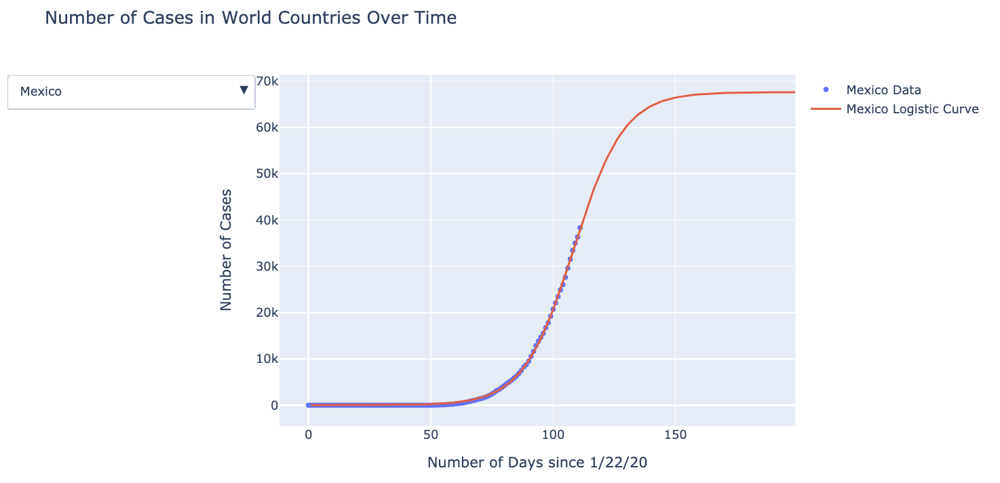

In [67]:
Image("Mexico_curve.png")

### Using the Logistic Curve to Make Predictions

We can see how accurately our logistic model, fitted to data up to a week before today (NUM_DAYS - 7), predicts the number of cases in countries today. We can see that it predicts the number of cases today with a strong amount of accuracy.

Changing this to only include data from two weeks ago also predicts the number of cases with a fairly strong accuracy. However, as we reduce the amount of data used to fit the logistic curve, naturally, our predictions become less accurate.

We then used the same curves fitted with all data to predict one week and one month into the future.

In [68]:
x_vals = [i for i in range(NUM_DAYS - 7)]
# store to plot later
all_y = {}
opt_params = {}
for r in time_series_covid19_confirmed_global.iterrows():
    #extract cases data from each row
    y_vals = [r[1][i] for i in range(NUM_DAYS - 7)]
    all_y[r[1]['Country']] = y_vals   
    try:
        #curve is fit
        params, cov = optimize.curve_fit(logistic_model, x_vals, y_vals, p0 = [70, max(y_vals), 0.01])
        y_pred_ct = logistic_model(x_vals, params[0], params[1], params[2])
        params = list(params)
        params.append(rmse(np.array(y_vals), np.array(y_pred_ct)))
        params = np.array(params)
        opt_params[r[1]['Country']] = params
    except:
        print(r[1]['Country'])

# Trying to predict last day in dataframe (today)
actual = time_series_covid19_confirmed_global.drop(columns = ['Lat', 'Long']).set_index("Country")
actual_y = actual[NUM_DAYS - 1]

# New logistic parameters
predict_today_df = pd.DataFrame.from_dict(opt_params, orient='index')
predict_today_df.columns = ["x_0", "L", "k", "rmse"]
predict_today_df = predict_today_df.drop(['US']) # dropped to improve plot axes
predict_today_df

Albania
Angola
Antigua and Barbuda
Bosnia and Herzegovina
Bulgaria
Congo (Brazzaville)
Costa Rica
Eswatini
Gambia
Israel
Kosovo
Kyrgyzstan
Madagascar
Montenegro
Papua New Guinea
Paraguay
Philippines
Uzbekistan
Zambia
Zimbabwe


,x_0,L,k,rmse
Afghanistan,134.233254,36212.102061,0.078757,162.301461
Algeria,204.954047,66906.534113,0.026735,909.864528
Andorra,71.774208,819.253333,0.130326,37.986904
Argentina,194.213020,397161.179970,0.048548,621.281157
Armenia,152.713577,42665.513646,0.055954,164.914329
...,...,...,...,...
Venezuela,196.379717,39726.986027,0.048367,93.163684
Vietnam,69.423279,345.176516,0.070818,23.766223
West Bank and Gaza,172.997928,13049.079748,0.107953,211.384101
Western Sahara,93.298792,9.781497,0.058158,0.975204


RMSE in Predicting Today's Cases From Last Week's Data: 22999.158032447136


(0.0, 30000.0)

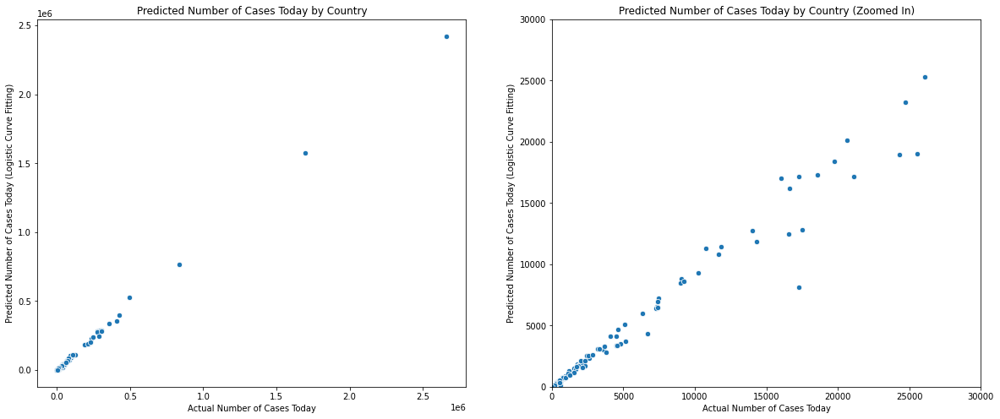

In [69]:
fig, ax = plt.subplots(1, 2, figsize=(20, 8))
sns.scatterplot(x= actual_y,
                y= logistic_model(NUM_DAYS - 1, predict_today_df["x_0"], predict_today_df["L"], predict_today_df["k"]), 
                alpha = 1, 
                s = 40,
                ax = ax[0])

sns.scatterplot(x= actual_y,
                y= logistic_model(NUM_DAYS - 1, predict_today_df["x_0"], predict_today_df["L"], predict_today_df["k"]), 
                alpha = 1, 
                s = 40,
                ax = ax[1])

error = rmse(actual_y, logistic_model(NUM_DAYS - 1, predict_today_df["x_0"], predict_today_df["L"], predict_today_df["k"]))

print("RMSE in Predicting Today's Cases From Last Week's Data: {}".format(error))
ax[0].set_xlabel("Actual Number of Cases Today")
ax[0].set_ylabel("Predicted Number of Cases Today (Logistic Curve Fitting)")
ax[0].set_title("Predicted Number of Cases Today by Country")

ax[1].set_xlabel("Actual Number of Cases Today")
ax[1].set_ylabel("Predicted Number of Cases Today (Logistic Curve Fitting)")
ax[1].set_title("Predicted Number of Cases Today by Country (Zoomed In)")
ax[1].set_ylim(0, 30000)
ax[1].set_xlim(0, 30000)

Predicting the number of cases in countries a week and a month from now.

In [70]:
opt_df["7DayPrediction"] = logistic_model(NUM_DAYS + 6, opt_df["x_0"], opt_df["L"], opt_df["k"])
opt_df["28DayPrediction"] = logistic_model(NUM_DAYS + 27, opt_df["x_0"], opt_df["L"], opt_df["k"])
opt_df

,x_0,L,k,rmse,7DayPrediction,28DayPrediction
Afghanistan,134.496677,36476.790998,0.077790,192.101117,36217.643957,36425.907166
Algeria,255.496213,171571.835897,0.024324,933.698179,33979.022081,50026.127291
Andorra,72.036341,826.786816,0.126474,40.897888,826.786717,826.786809
Angola,272.422815,49505.375720,0.045674,11.513719,1600.080011,3968.907194
Antigua and Barbuda,272.384145,604.136072,0.020683,7.780596,106.785219,150.409144
...,...,...,...,...,...,...
Venezuela,209.253342,60149.670996,0.045618,110.461393,22520.413801,36652.865980
Vietnam,72.369545,362.562047,0.059269,32.638653,362.350515,362.501091
West Bank and Gaza,173.709721,13484.817337,0.105087,209.455706,12510.514380,13370.228790
Western Sahara,93.637954,9.835931,0.057480,0.958283,9.811579,9.828635


We believe that these estimates will be more accurate than those from our earlier linear model, because they use data from the entire time series fitted a logistic curve. However, we believe the accuracy of this model could be improved by bringing in other information about the risk factors and countermeasures being implemented in each county, since these measures are taken to change the shape of the curve.

### Further Questions

Further questions that are opened is understanding how the number of confirmed coronavirus cases and deaths changed on a global level with the implementation of shelter in place regulations. This would be to evaluate the effectiveness of these regulatory methods. 

After completing the analysis, we woud like to further research different levels of regulation, looking into the effectiveness of methods such as closing schools, colleges, public spaces, and workplaces partially and entirely. We began this analysis on the county level, but weren't able to make solid conclusions, and left this analysis in the appendix notebook. 

On a global and on a country level, this information would be extremely helpful to lawmakers and the general public to understand which practices are best at "flattening the curve," and how other uncontrollable factors may put certain populations at risk.